In [1]:
# Imports
from massimal import annotation
from pathlib import Path
import json
import skimage.io
import matplotlib.pyplot as plt
import matplotlib
import numpy as np

In [2]:
# Paths
rgb_im_dir = Path("/home/mha114/data/massimal/vega_sola/hyperspec/annotation/rgb_images/")
test_dir = Path("/home/mha114/data/massimal/vega_sola/hyperspec/annotation/v2.1/png_gray/test/")
train_val_dir = Path("/home/mha114/data/massimal/vega_sola/hyperspec/annotation/v2.1/png_gray/train_val/")
class_index_json = Path("/home/mha114/data/massimal/vega_sola/hyperspec/annotation/v2.1/png_gray/label_classes.json")
class_hierarchy_json = Path("/home/mha114/code/github/massimal/annotation/massimal_annotation_class_hierarchy.json")

In [3]:
# Parameters

# Create custom colormap for classes (including background:0)
custom_cmap = matplotlib.colors.ListedColormap(colors=['darkgray',           # Background - darkgray 
                                                       'darkturquoise',   # Sand
                                                       'pink',            # Bedrock
                                                       'royalblue',       # Cobble
                                                       'magenta',         # Maerl bed
                                                       'seagreen',        # Rockweed
                                                       'darkorange',      # Kelp 
                                                       'red',             # Chorda filum (alt. 'lime'?)
                                                       'brown'])          # Brown algae

In [5]:
# Load and print annotation classes 
class_indices = annotation.read_hasty_metadata(class_index_json)
for key in class_indices.keys():
    print(f'{key}: {class_indices[key]}')

Deep water: 1
Substrate: 2
Rock: 3
Bedrock: 4
Boulder: 5
Cobble: 6
Gravel: 7
Sediment: 8
Sand: 9
Mud: 10
Algae: 11
Brown algae: 12
Kelp: 13
Laminaria hyperborea: 14
Laminaria digitata: 15
Sacchoriza polyides: 16
Saccharina latissima: 17
Alaria esculenta: 18
Rockweed: 19
Rockweed, hydrolittoral: 20
Ascophyllum nodosum: 21
Fucus vesiculosus: 22
Fucus serratus: 23
Halidrys siliquosa: 24
Rockweed, geolittoral: 25
Fucus spiralis: 26
Pelvetia canaliculata: 27
Brown algae, other: 28
Chorda filum: 29
Desmarestia aculeata: 30
Red algae: 31
Coralline algae: 32
Maerl: 33
Green algae: 34
Turf: 35
Animals: 36
Mussels: 37
Mytilus edilus: 38
Trawl track: 39


In [6]:
# Load class hierarchy
with open(class_hierarchy_json,'r') as file:
    class_hierarchy = json.load(file)
print(class_hierarchy)

{'Deep water': [], 'Algae': {'Brown algae': {'Kelp': ['Laminaria hyperborea', 'Laminaria digitata', 'Sacchoriza polyides', 'Saccharina latissima', 'Alaria esculenta'], 'Rockweed': {'Rockweed, hydrolittoral': ['Ascophyllum nodosum', 'Fucus vesiculosus', 'Fucus serratus', 'Halidrys siliquosa'], 'Rockweed, geolittoral': ['Fucus spiralis', 'Pelvetia canaliculata']}, 'Brown algae, other': ['Chorda filum', 'Desmarestia aculeata']}, 'Red algae': {'Coralline algae': ['Maerl']}, 'Green algae': [], 'Turf': []}, 'Substrate': {'Rock': ['Bedrock', 'Boulder', 'Cobble', 'Gravel'], 'Sediment': ['Sand', 'Mud']}, 'Animals': {'Mussels': ['Mytilus edilus']}, 'Human activity': ['Trawl track']}


In [8]:
# Define grouped classes
grouped_classes = ['Sand','Bedrock','Cobble','Maerl','Rockweed','Kelp','Chorda filum']
grouped_class_indices = annotation.class_indices_from_hierarchy(class_hierarchy,class_indices,grouped_classes)
grouped_class_indices['Brown algae (deep)'] = {class_indices['Brown algae']}
print(grouped_class_indices)

class_names = ['Background'] + [k for k in grouped_class_indices.keys()]
print(f'{class_names=}')

{'Sand': {9}, 'Bedrock': {4}, 'Cobble': {6}, 'Maerl': {33}, 'Rockweed': {19, 20, 21, 22, 23, 24, 25, 26, 27}, 'Kelp': {13, 14, 15, 16, 17, 18}, 'Chorda filum': {29}, 'Brown algae (deep)': {12}}
class_names=['Background', 'Sand', 'Bedrock', 'Cobble', 'Maerl', 'Rockweed', 'Kelp', 'Chorda filum', 'Brown algae (deep)']


In [20]:
# Set plotting info based on class info
cbar_vmin = 0
cbar_vmax = len(class_names)-0.01
cbar_ticks = [i+0.5 for i in range(len(class_names))]
cbar_ticklabels = class_names

print(cbar_ticks)
print(cbar_ticklabels)

[0.5, 1.5, 2.5, 3.5, 4.5, 5.5, 6.5, 7.5, 8.5]
['Background', 'Sand', 'Bedrock', 'Cobble', 'Maerl', 'Rockweed', 'Kelp', 'Chorda filum', 'Brown algae (deep)']


Vega_SolaNW_Coast1_Pika_L_10-Crop Wavelengths.bip.png


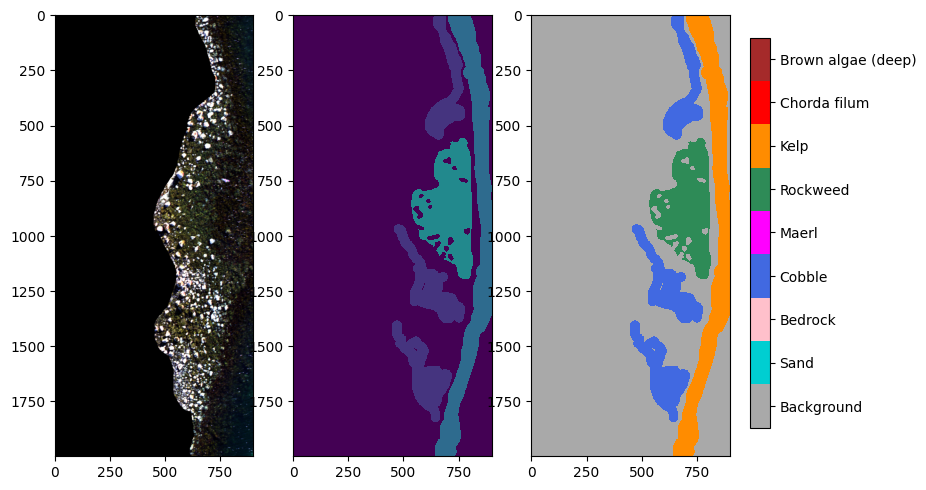

Vega_SolaNW_Coast1_Pika_L_11-Crop Wavelengths.bip.png


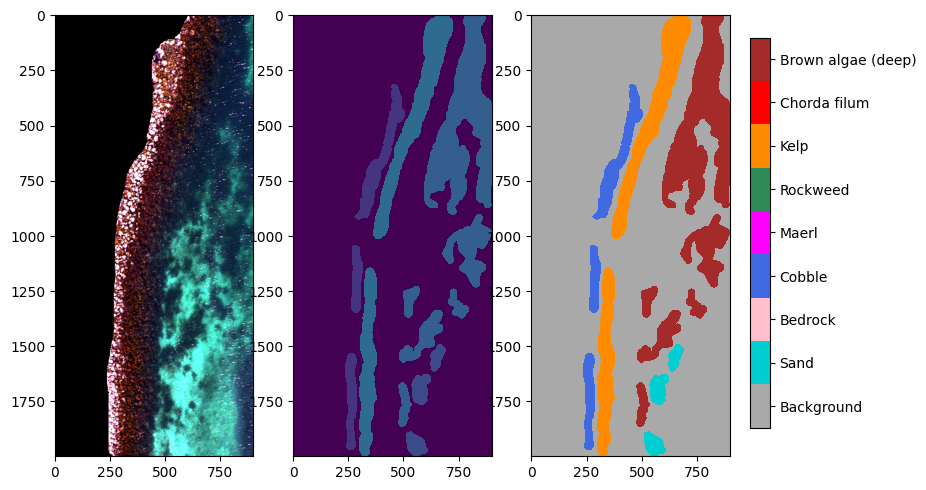

Vega_SolaNW_Coast1_Pika_L_12-Crop Wavelengths.bip.png


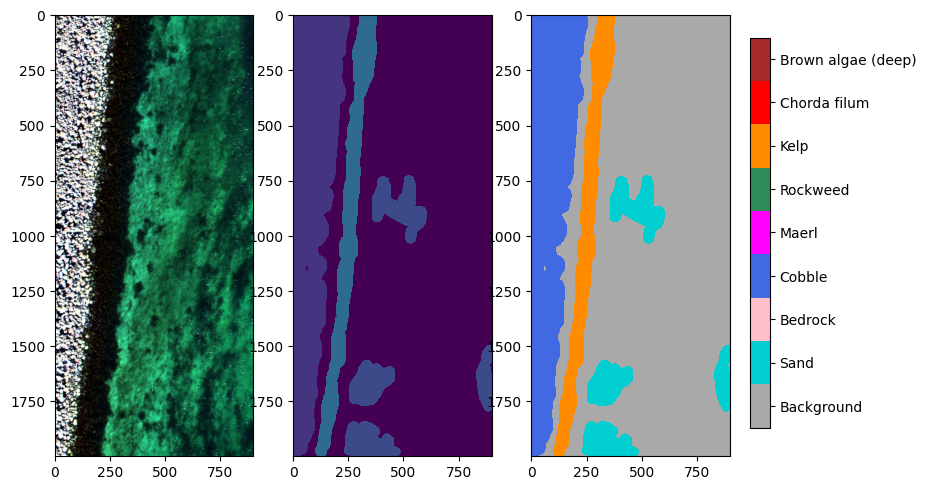

Vega_SolaNW_Coast1_Pika_L_13-Crop Wavelengths.bip.png


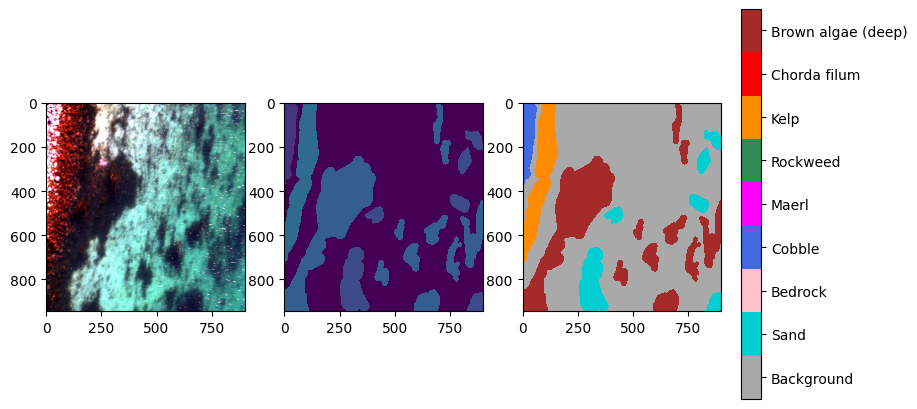

Vega_SolaNW_Coast1_Pika_L_15-Crop Wavelengths.bip.png


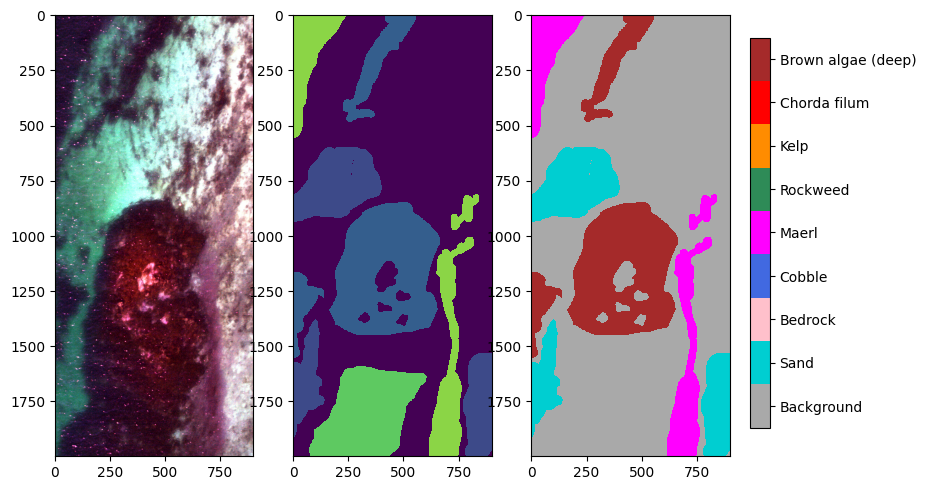

Vega_SolaNW_Coast1_Pika_L_16-Crop Wavelengths.bip.png


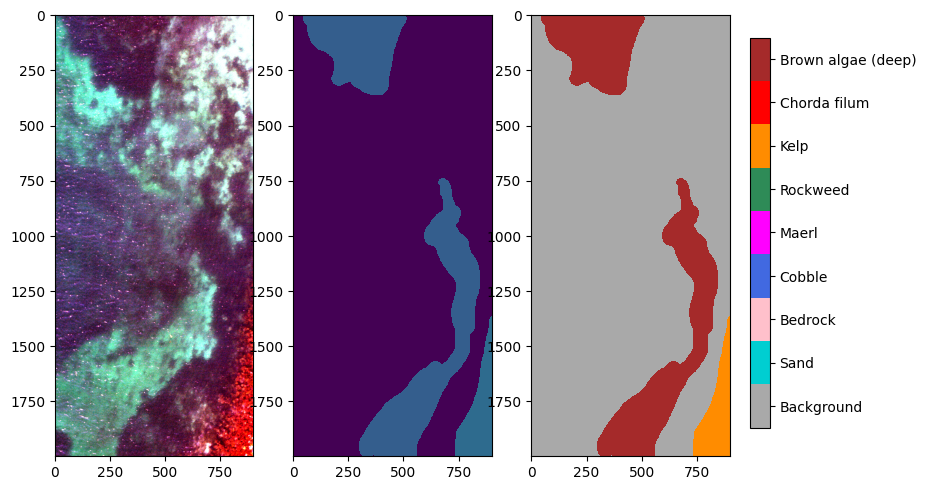

Vega_SolaNW_Coast1_Pika_L_17-Crop Wavelengths.bip.png


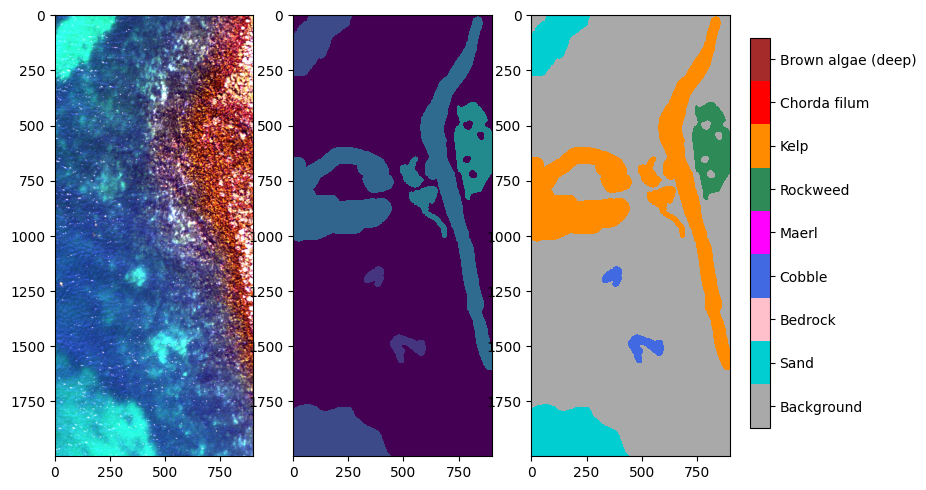

Vega_SolaNW_Coast1_Pika_L_18-Crop Wavelengths.bip.png


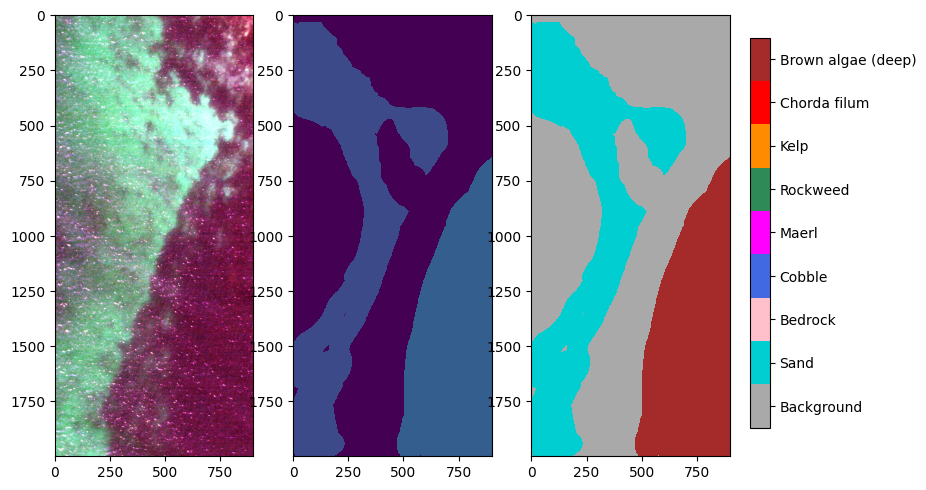

Vega_SolaNW_Coast1_Pika_L_22-Crop Wavelengths.bip.png


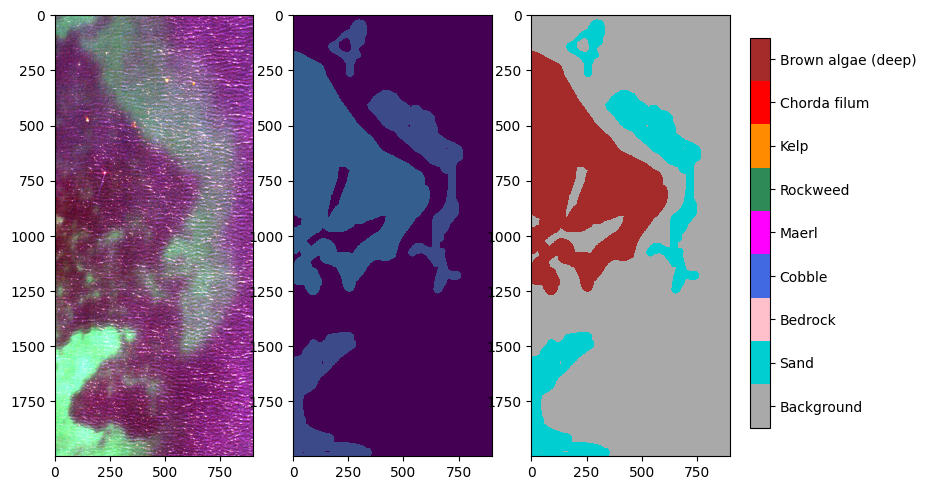

Vega_SolaNW_Coast1_Pika_L_23-Crop Wavelengths.bip.png


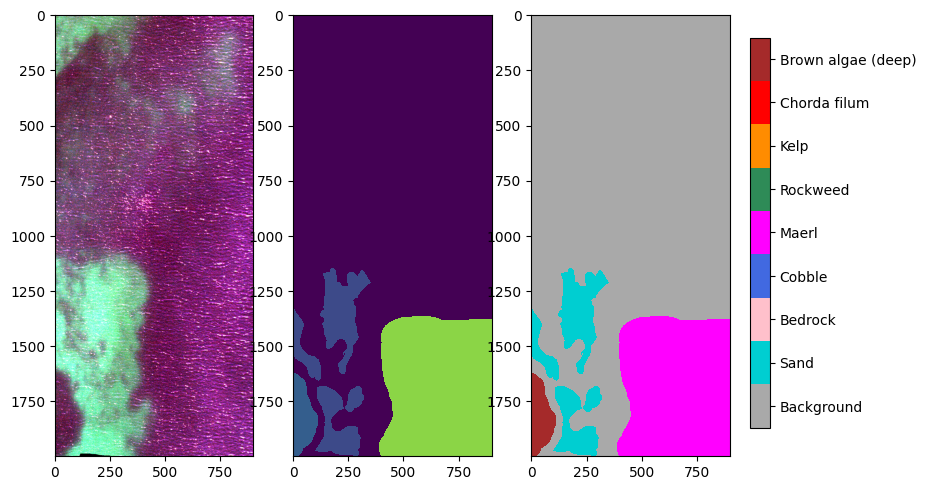

Vega_SolaNW_Coast1_Pika_L_24-Crop Wavelengths.bip.png


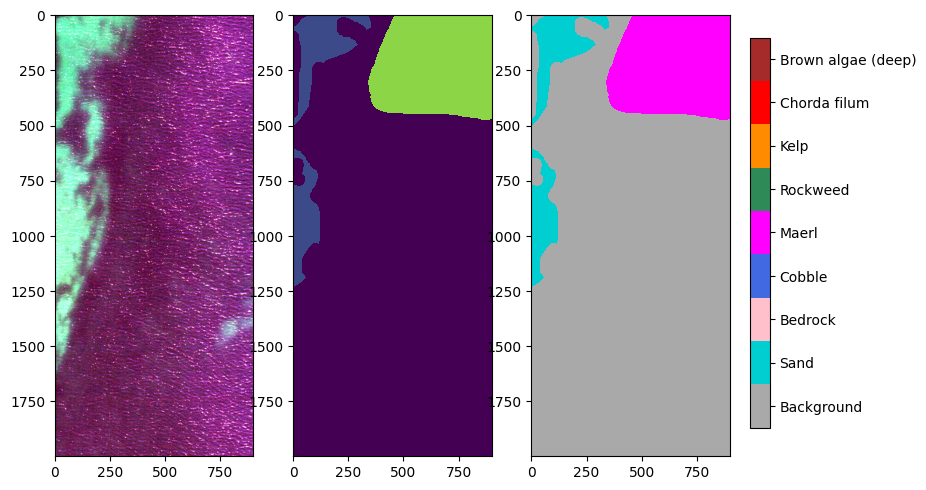

Vega_SolaNW_Coast1_Pika_L_6-Crop Wavelengths.bip.png


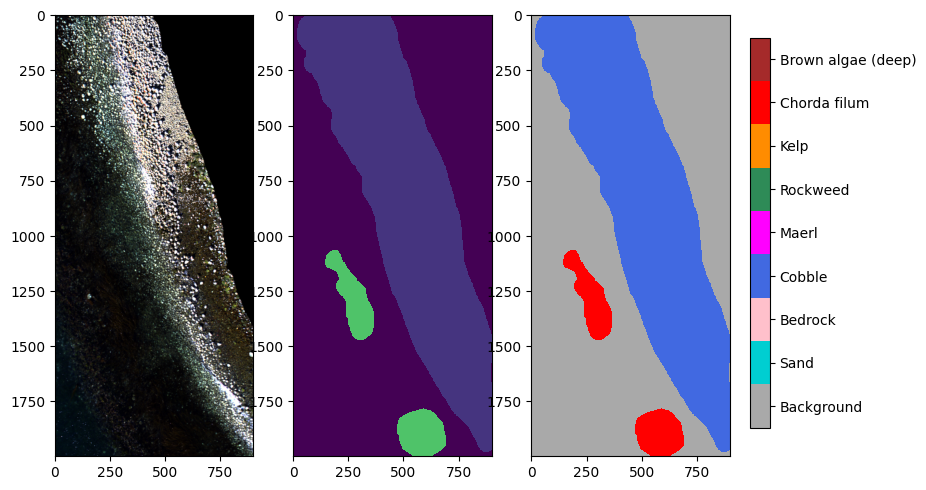

Vega_SolaNW_Coast1_Pika_L_7-Crop Wavelengths.bip.png


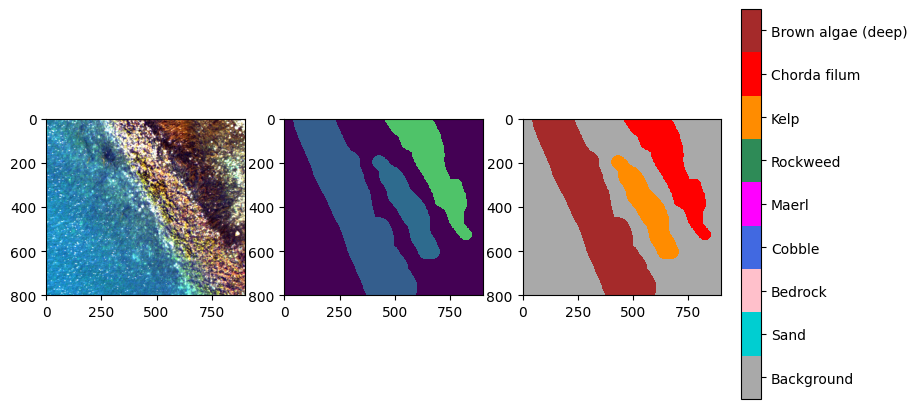

Vega_SolaNW_Coast1_Pika_L_8-Crop Wavelengths.bip.png


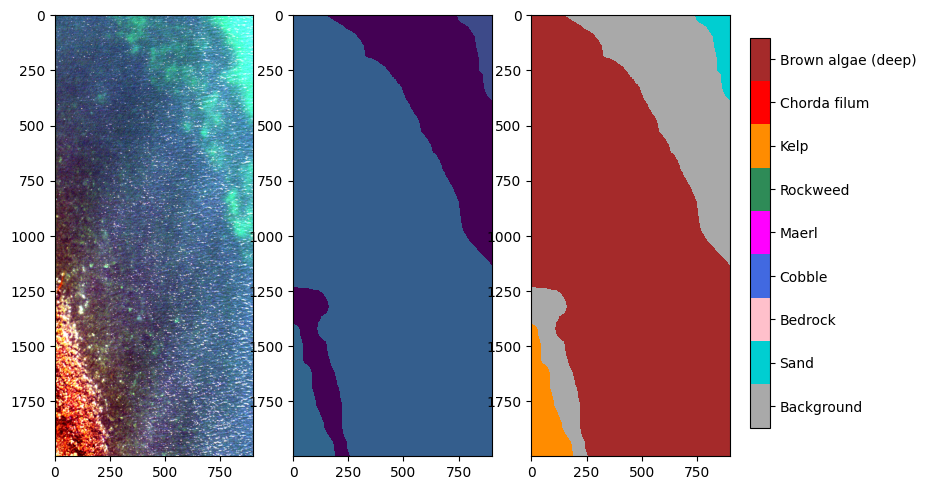

Vega_SolaNW_Coast1_Pika_L_9-Crop Wavelengths.bip.png


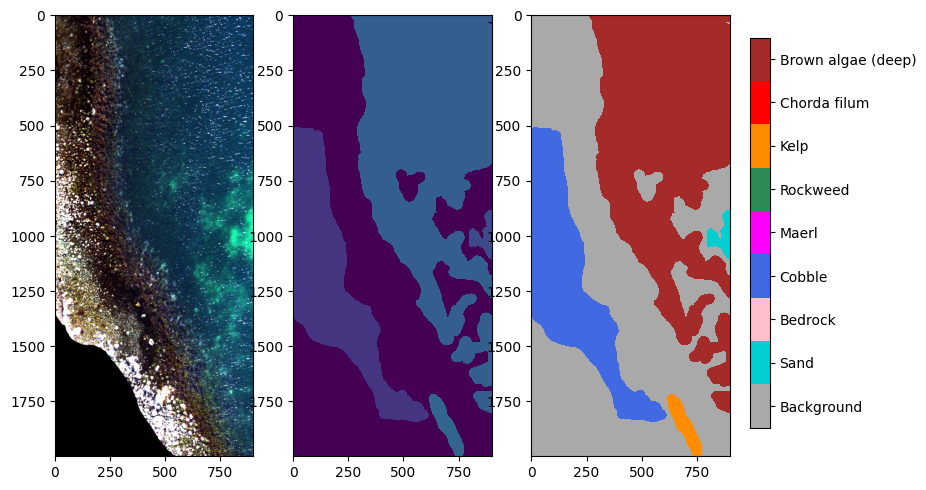

Vega_SolaNW_Coast2_Pika_L_15-Crop Wavelengths.bip.png


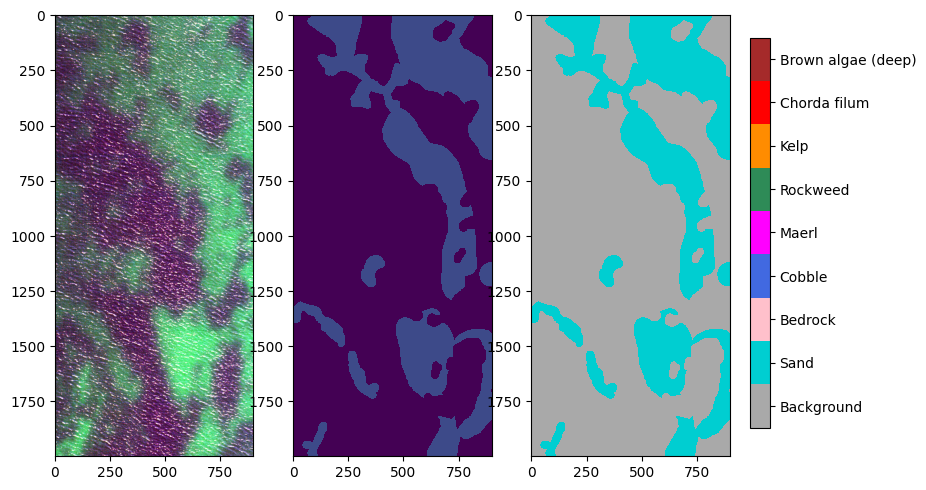

Vega_SolaNW_Coast2_Pika_L_16-Crop Wavelengths.bip.png


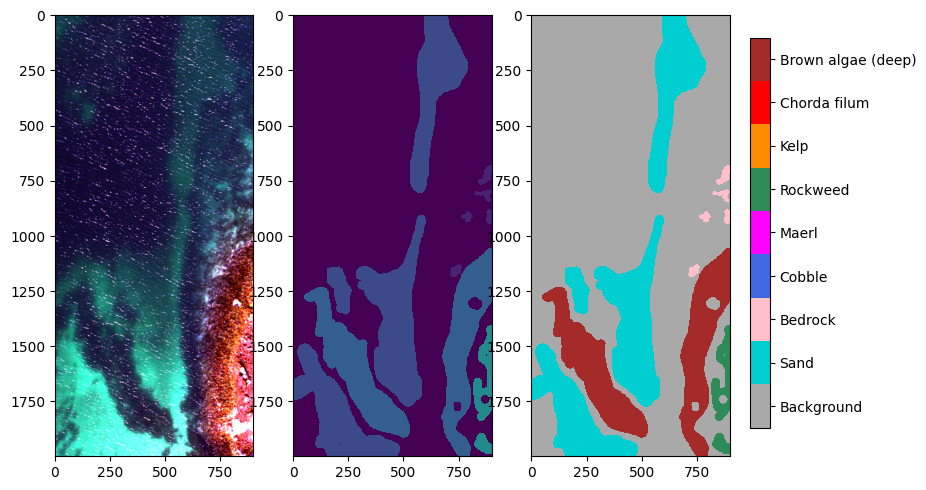

Vega_SolaNW_Coast2_Pika_L_17-Crop Wavelengths.bip.png


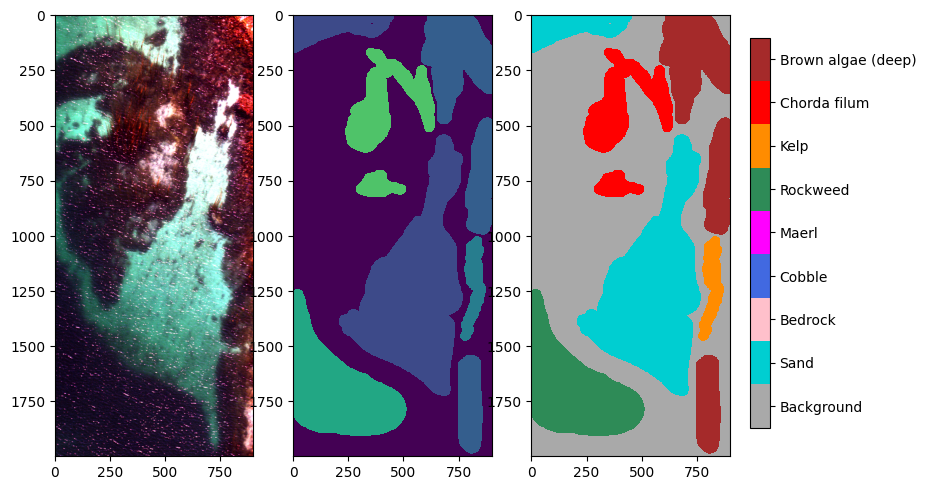

Vega_SolaNW_Coast2_Pika_L_19-Crop Wavelengths.bip.png


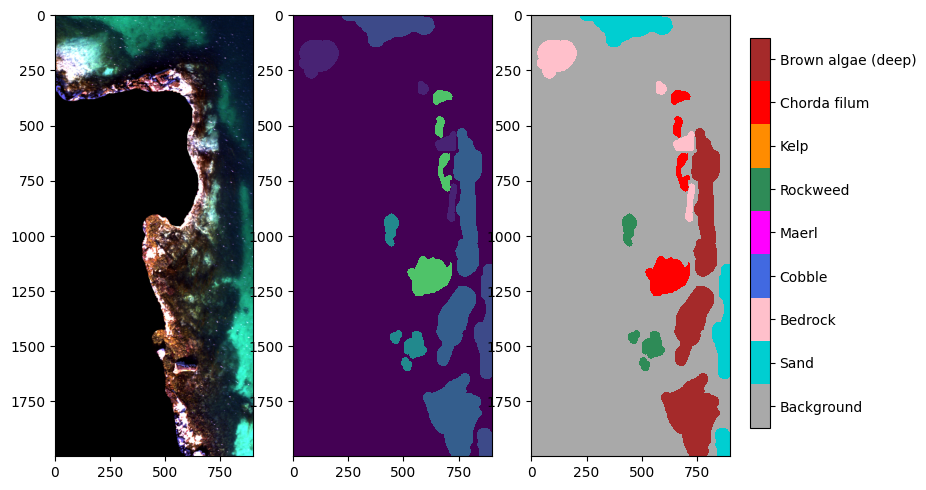

Vega_SolaNW_Coast2_Pika_L_20-Crop Wavelengths.bip.png


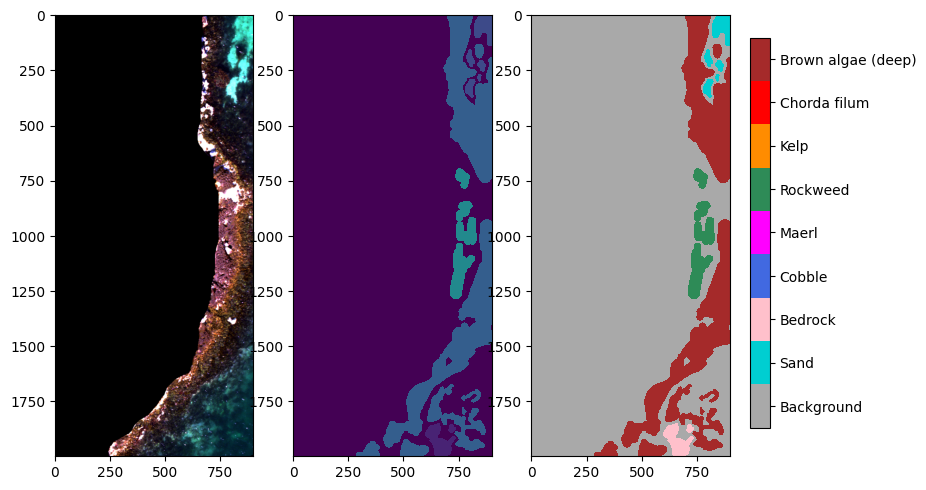

Vega_SolaNW_Coast2_Pika_L_21-Crop Wavelengths.bip.png


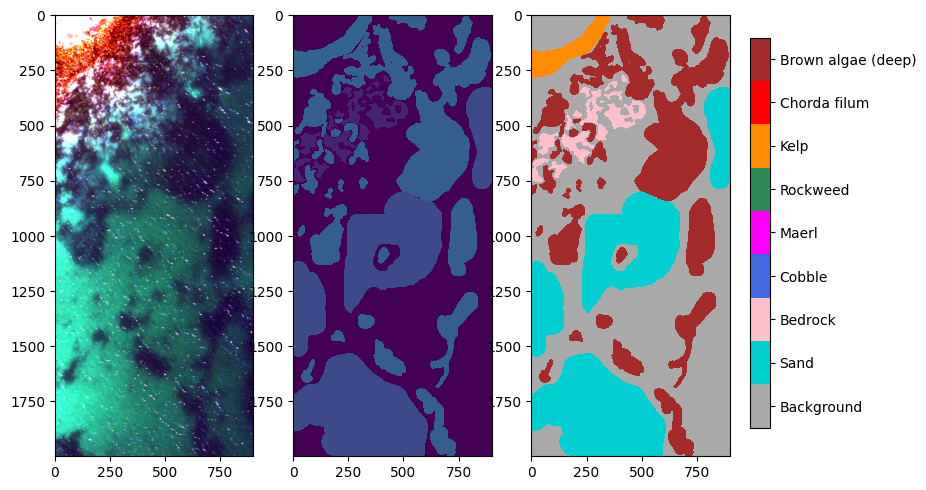

Vega_SolaNW_Coast2_Pika_L_5-Crop Wavelengths.bip.png


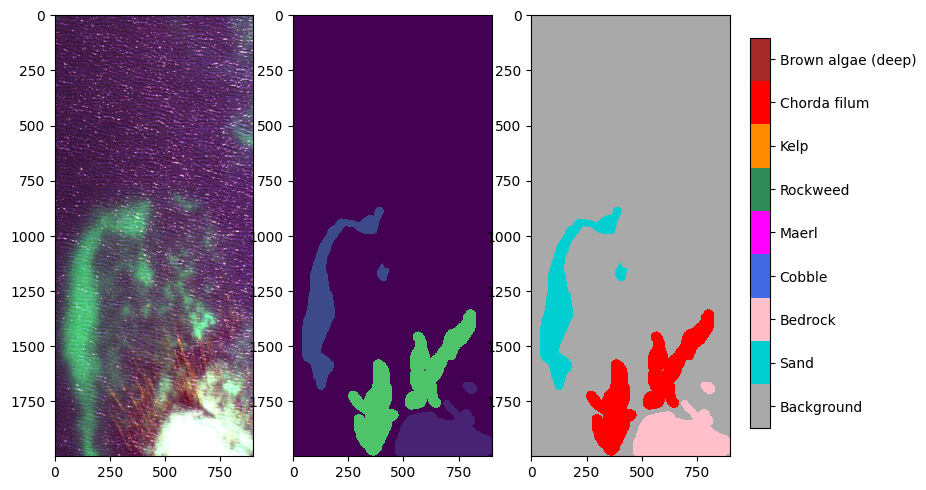

Vega_SolaNW_Coast2_Pika_L_6-Crop Wavelengths.bip.png


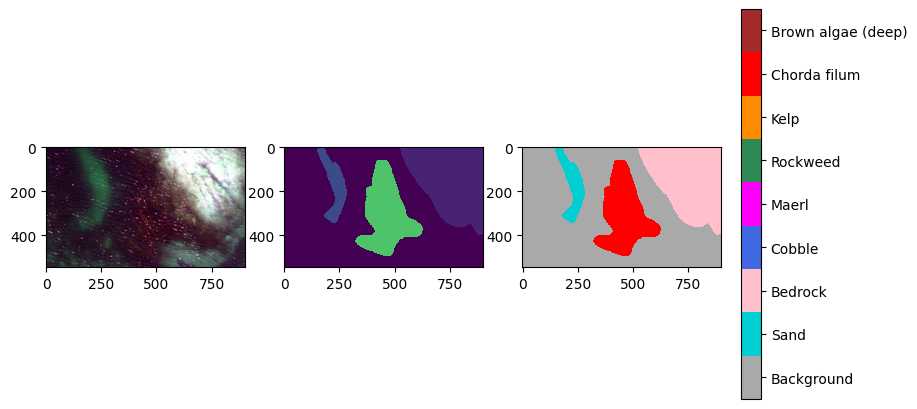

Vega_SolaNW_Coast2_Pika_L_7-Crop Wavelengths.bip.png


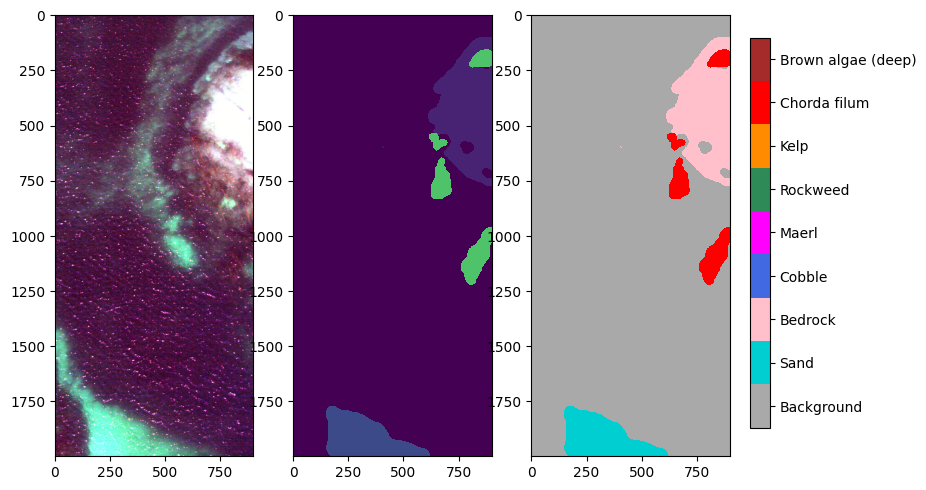

Vega_SolaNW_Coast3_Pika_L_10-Crop Wavelengths.bip.png


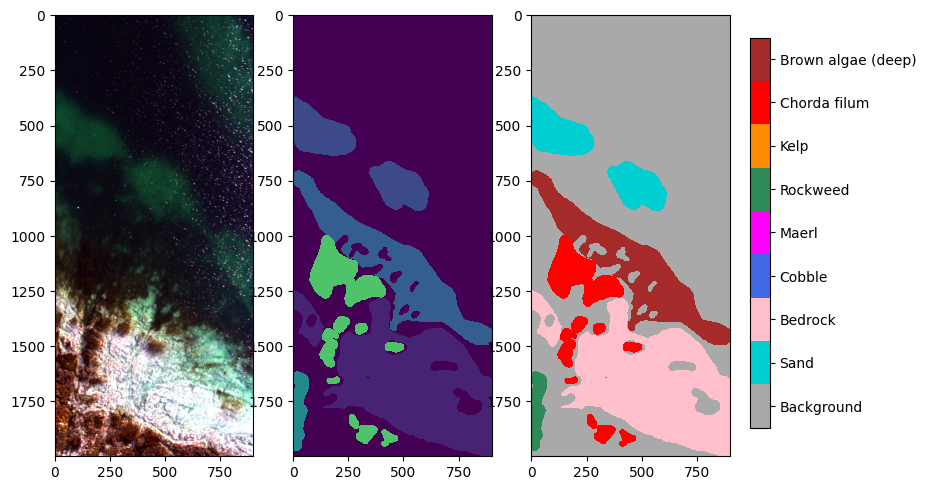

Vega_SolaNW_Coast3_Pika_L_11-Crop Wavelengths.bip.png


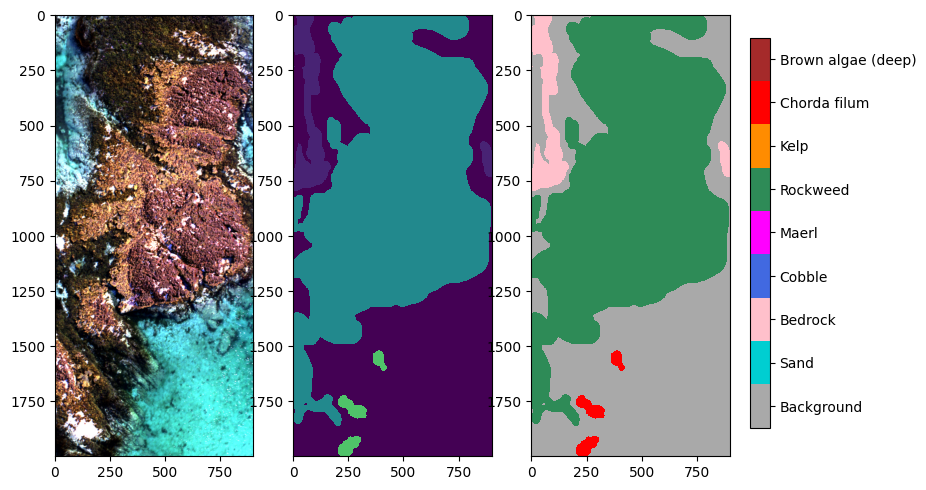

Vega_SolaNW_Coast3_Pika_L_12-Crop Wavelengths.bip.png


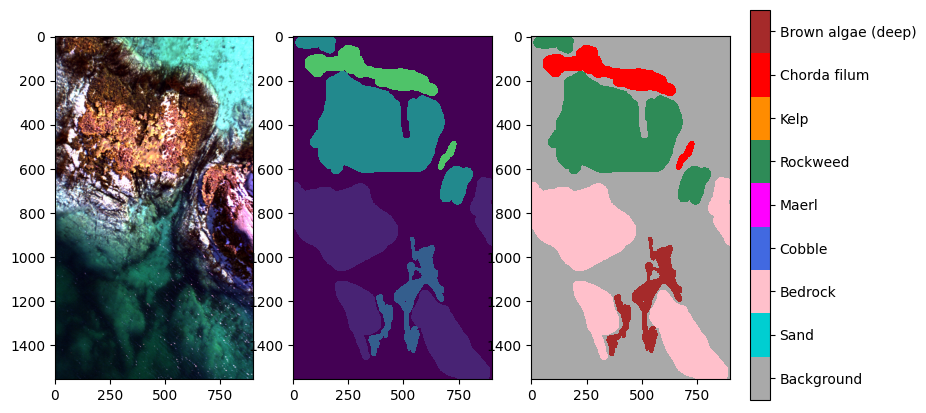

Vega_SolaNW_Coast3_Pika_L_13-Crop Wavelengths.bip.png


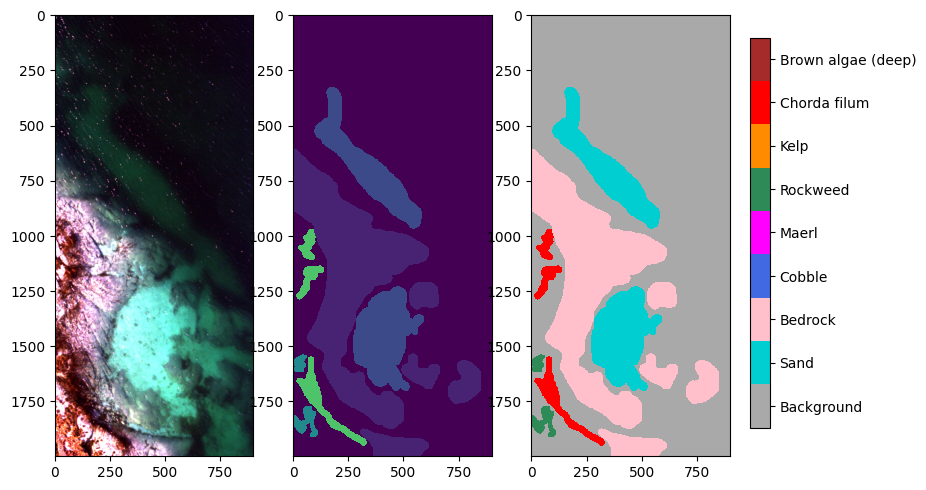

Vega_SolaNW_Coast3_Pika_L_14-Crop Wavelengths.bip.png


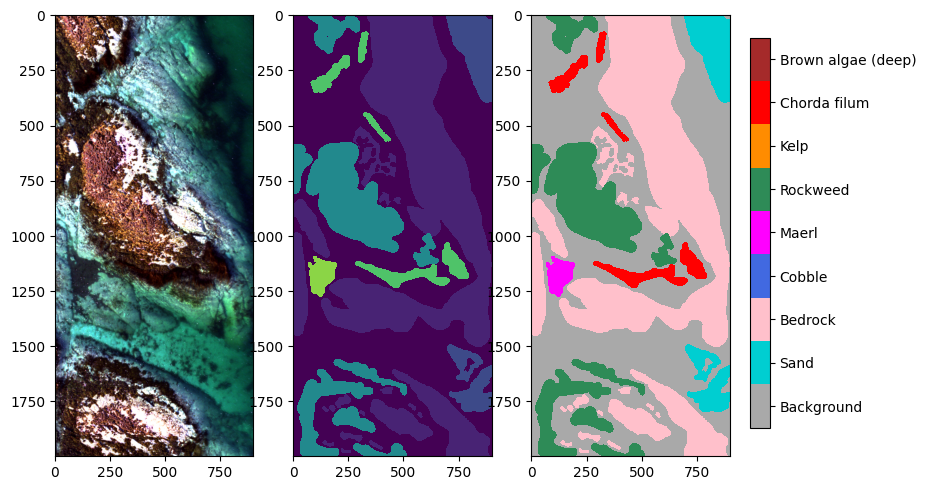

Vega_SolaNW_Coast3_Pika_L_15-Crop Wavelengths.bip.png


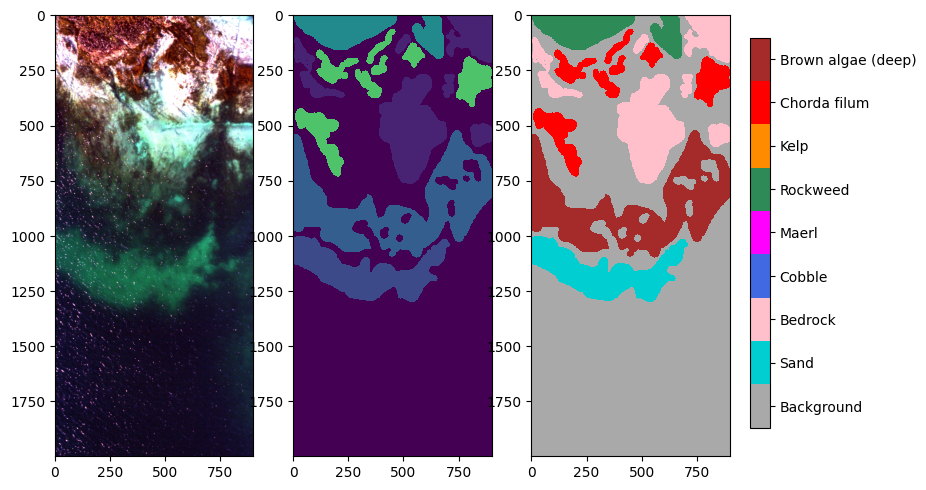

Vega_SolaNW_Coast3_Pika_L_18-Crop Wavelengths.bip.png


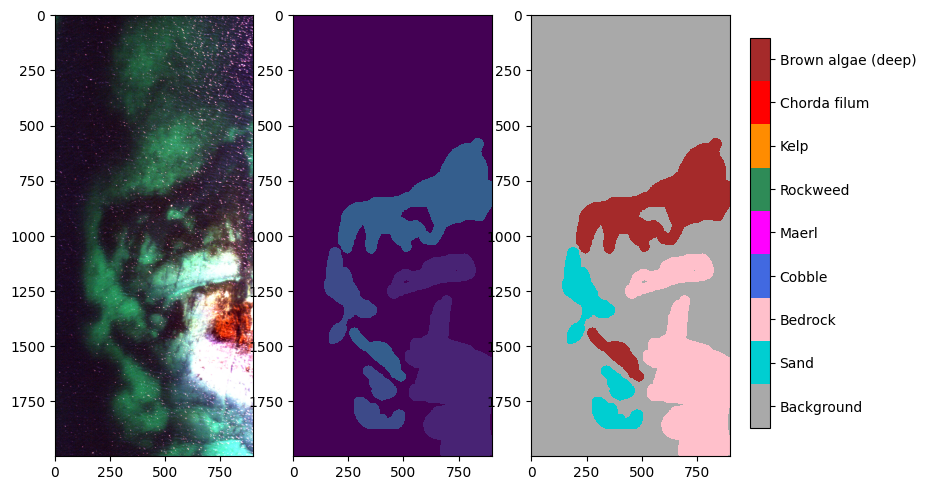

Vega_SolaNW_Coast3_Pika_L_19-Crop Wavelengths.bip.png


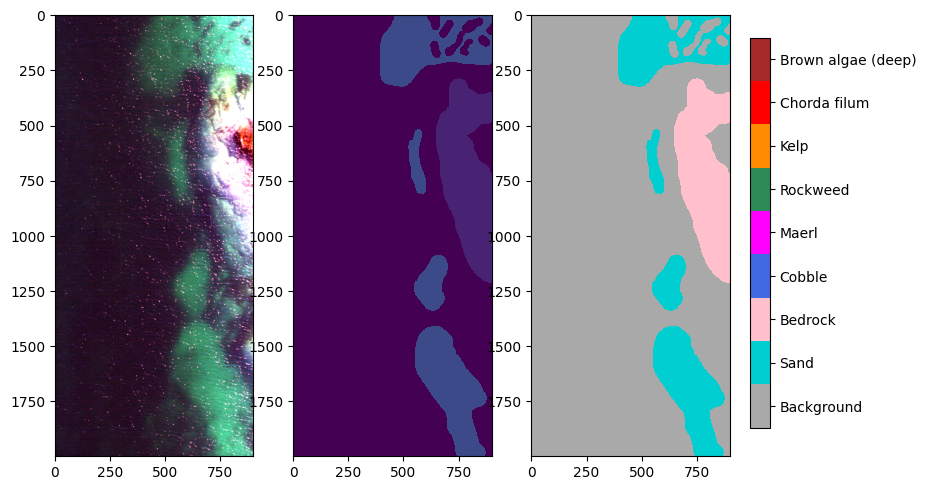

Vega_SolaNW_Coast3_Pika_L_2-Crop Wavelengths.bip.png


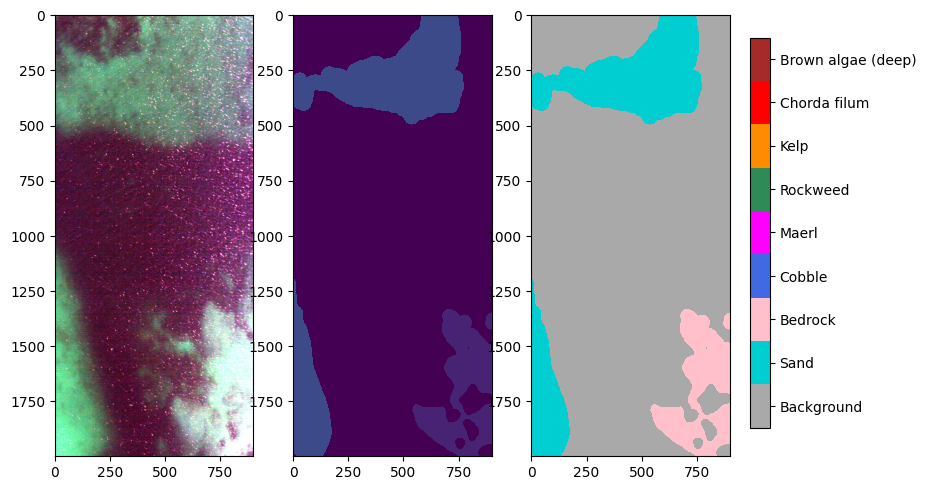

Vega_SolaNW_Coast3_Pika_L_21-Crop Wavelengths.bip.png


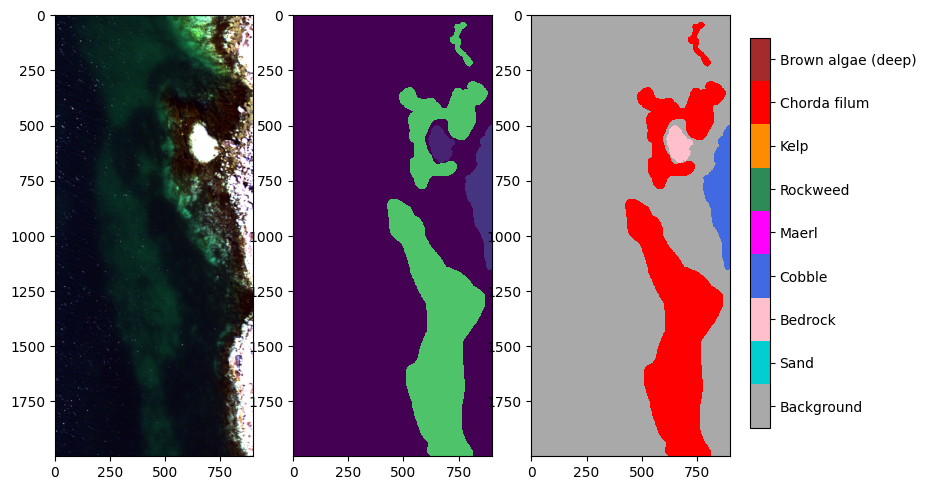

Vega_SolaNW_Coast3_Pika_L_22-Crop Wavelengths.bip.png


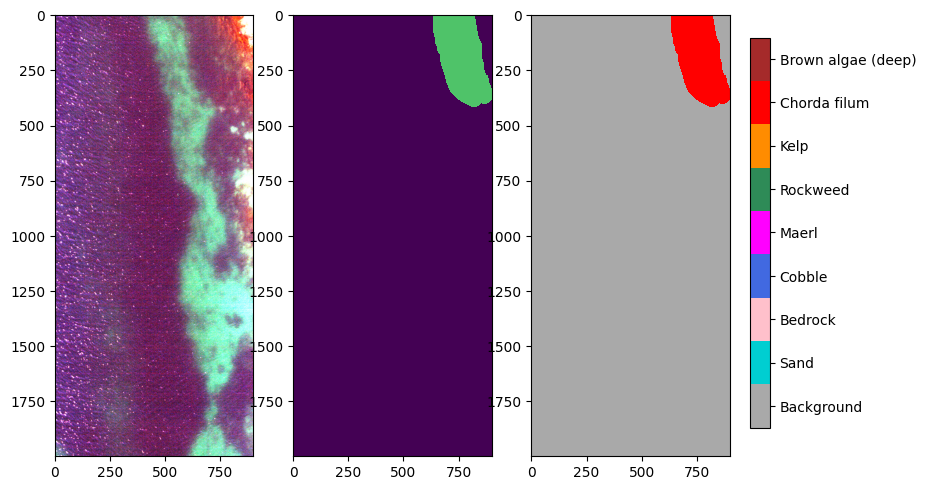

Vega_SolaNW_Coast3_Pika_L_23-Crop Wavelengths.bip.png


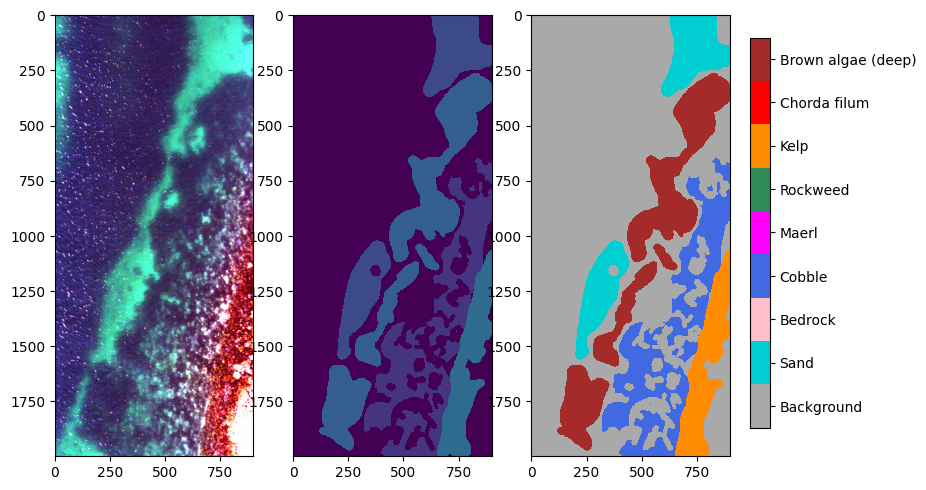

Vega_SolaNW_Coast3_Pika_L_24-Crop Wavelengths.bip.png


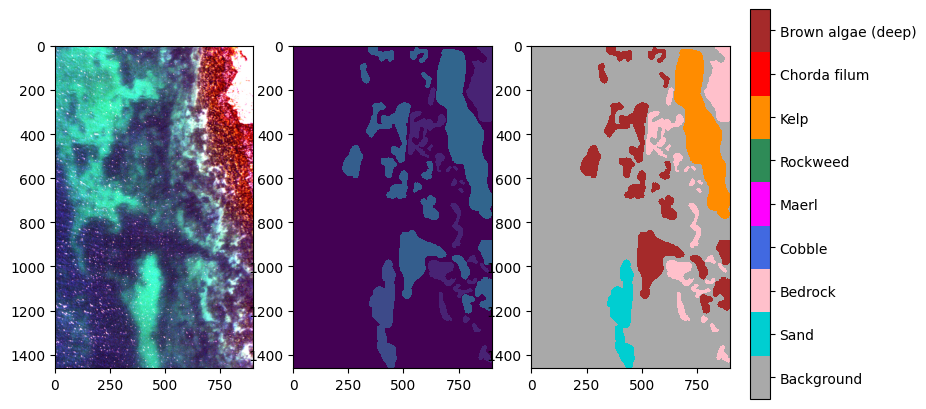

Vega_SolaNW_Coast3_Pika_L_25-Crop Wavelengths.bip.png


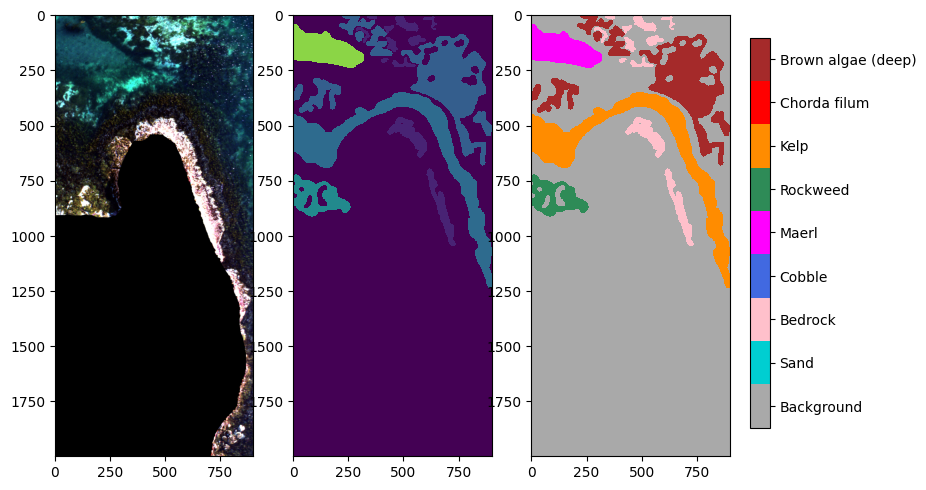

Vega_SolaNW_Coast3_Pika_L_26-Crop Wavelengths.bip.png


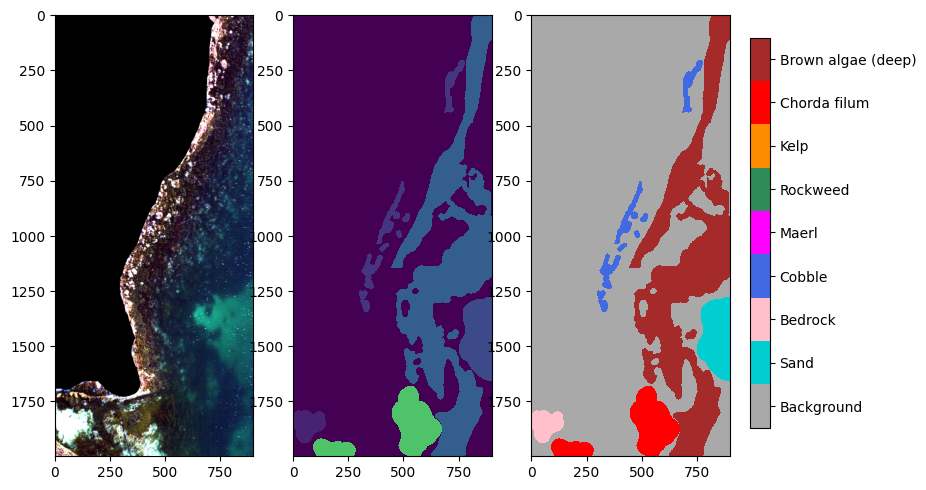

Vega_SolaNW_Coast3_Pika_L_27-Crop Wavelengths.bip.png


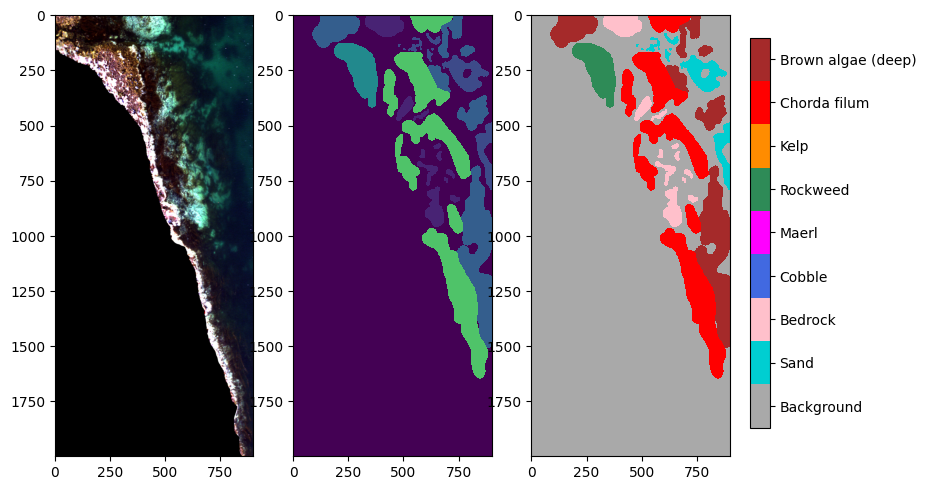

Vega_SolaNW_Coast3_Pika_L_3-Crop Wavelengths.bip.png


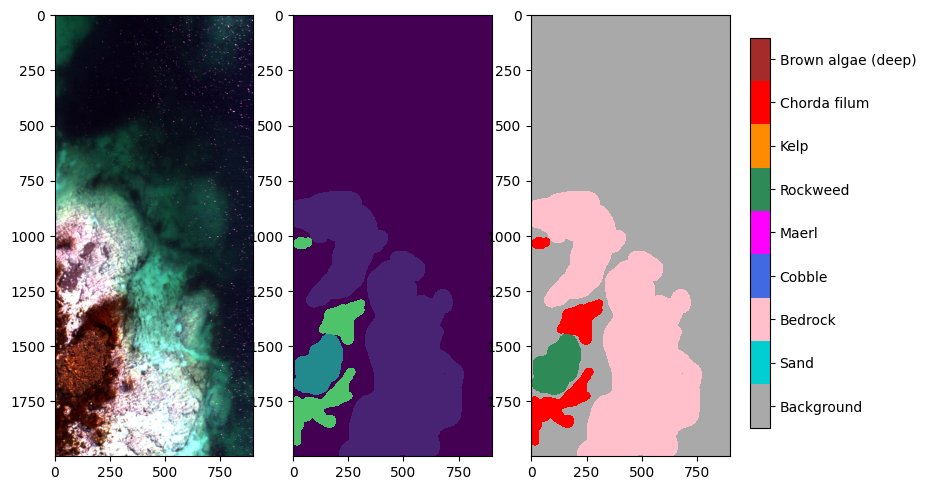

Vega_SolaNW_Coast3_Pika_L_4-Crop Wavelengths.bip.png


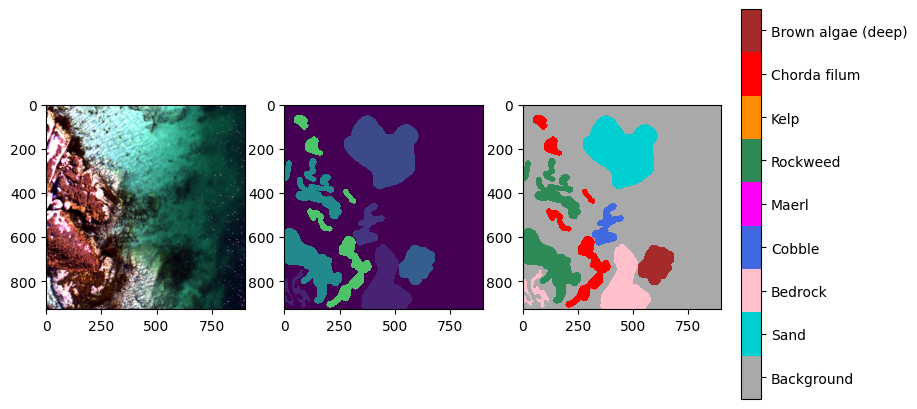

Vega_SolaNW_Coast3_Pika_L_5-Crop Wavelengths.bip.png


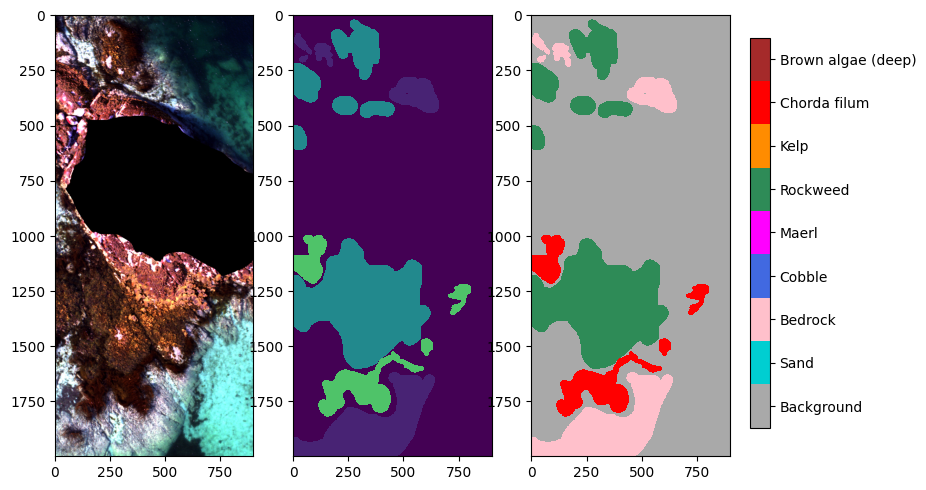

Vega_SolaNW_Coast3_Pika_L_6-Crop Wavelengths.bip.png


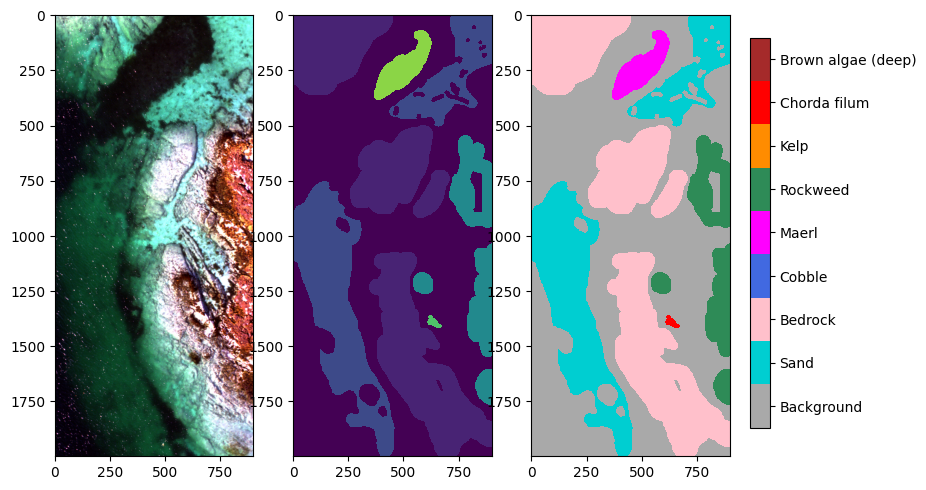

Vega_SolaNW_Sound1_Pika_L_1-Crop Wavelengths.bip.png


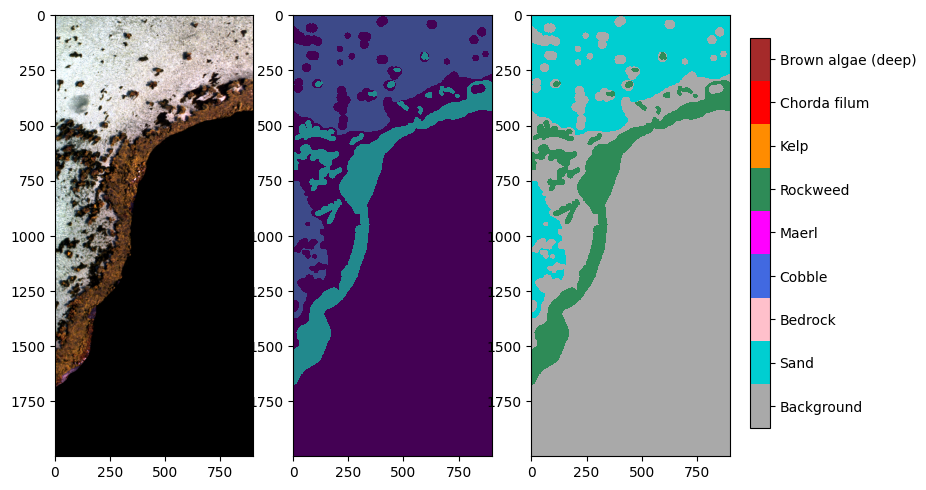

Vega_SolaNW_Sound1_Pika_L_10-Crop Wavelengths.bip.png


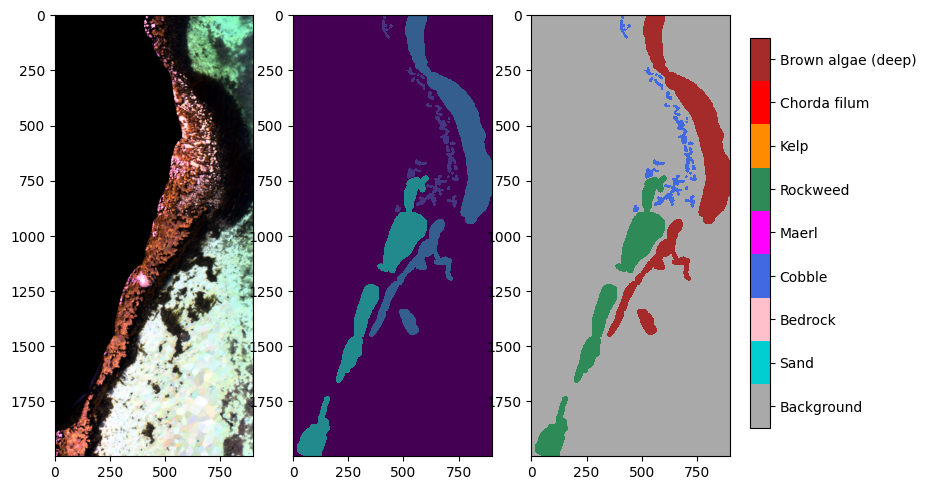

Vega_SolaNW_Sound1_Pika_L_11-Crop Wavelengths.bip.png


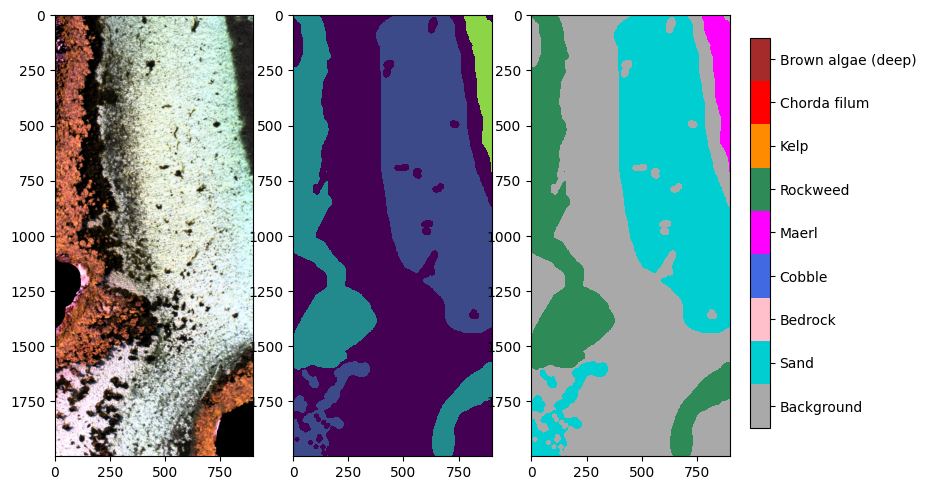

Vega_SolaNW_Sound1_Pika_L_12-Crop Wavelengths.bip.png


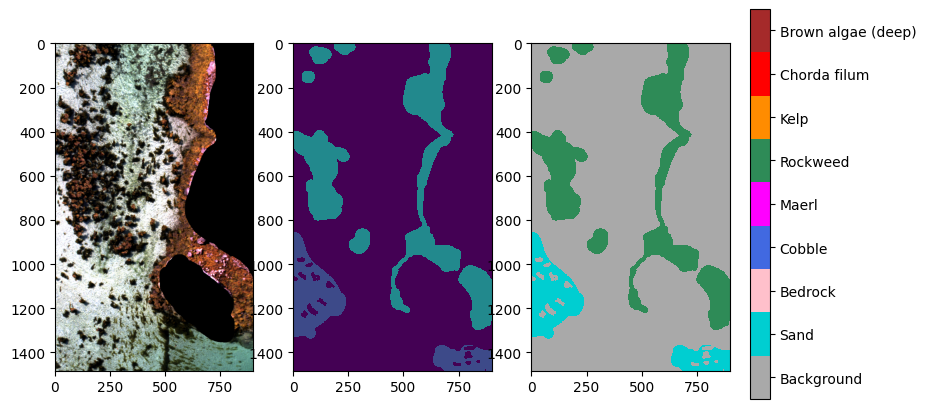

Vega_SolaNW_Sound1_Pika_L_13-Crop Wavelengths.bip.png


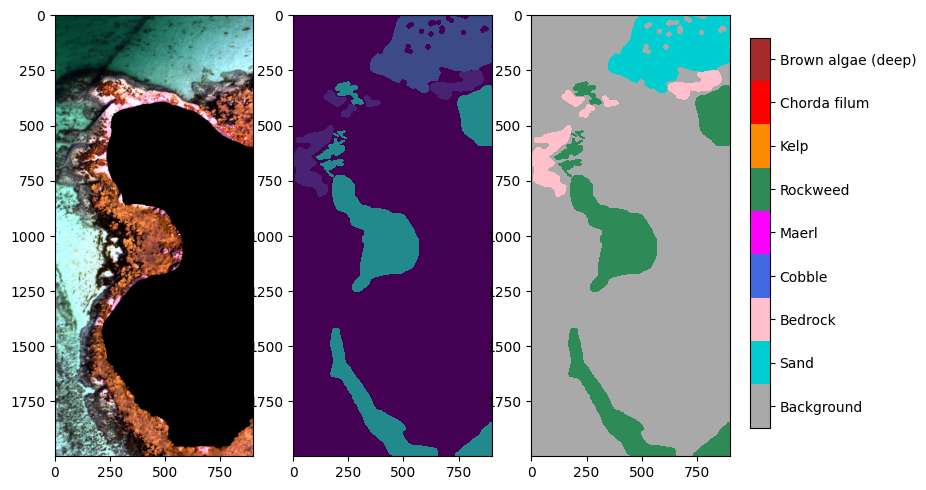

Vega_SolaNW_Sound1_Pika_L_14-Crop Wavelengths.bip.png


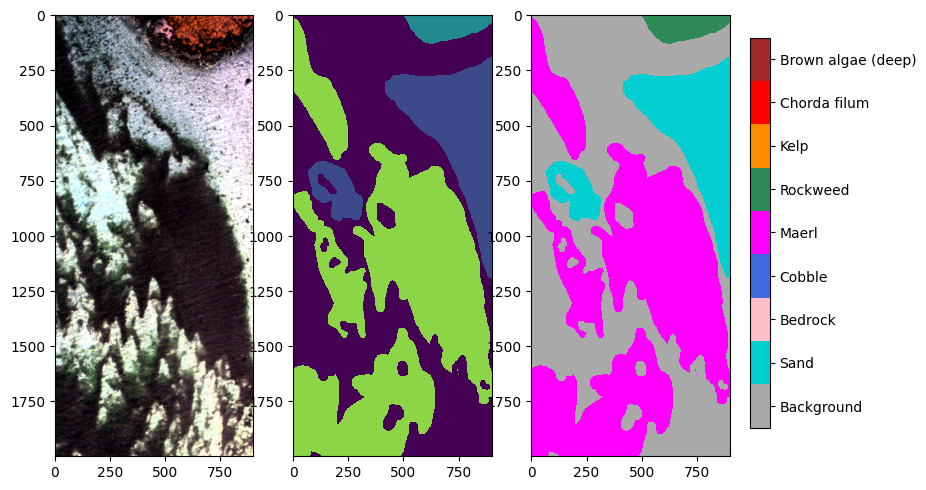

Vega_SolaNW_Sound1_Pika_L_15-Crop Wavelengths.bip.png


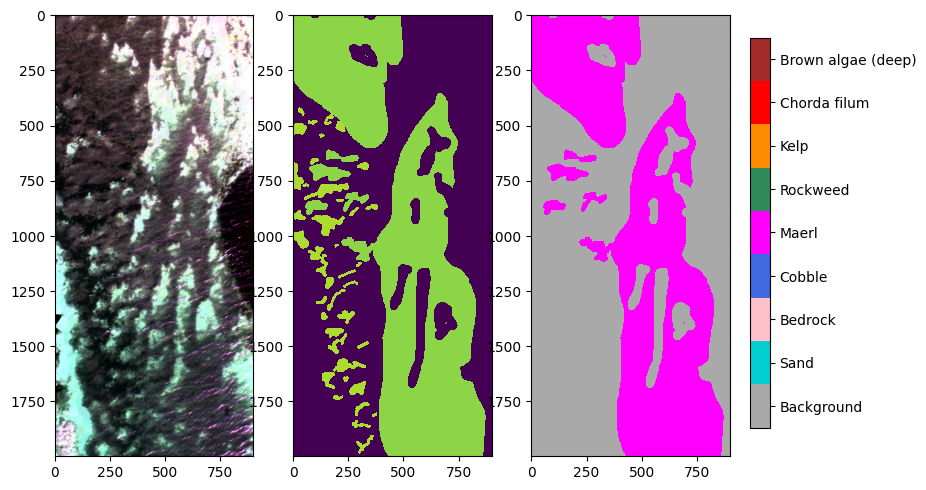

Vega_SolaNW_Sound1_Pika_L_16-Crop Wavelengths.bip.png


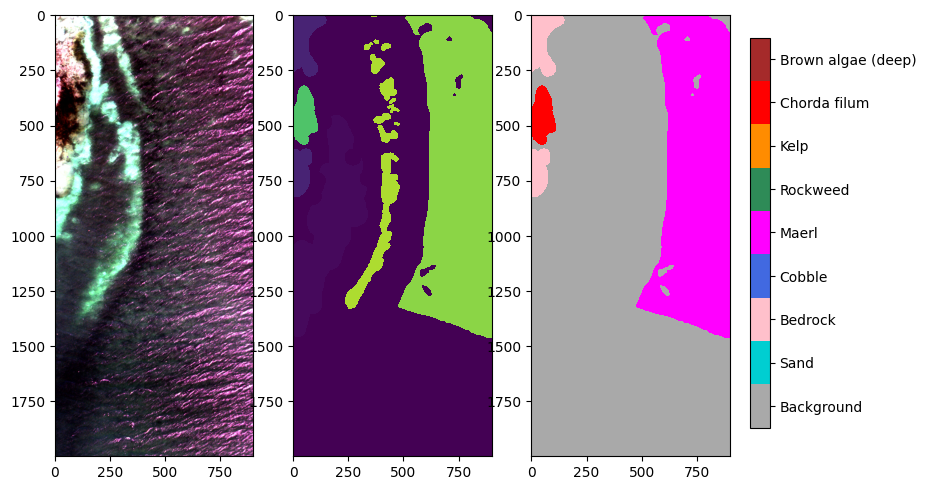

Vega_SolaNW_Sound1_Pika_L_17-Crop Wavelengths.bip.png


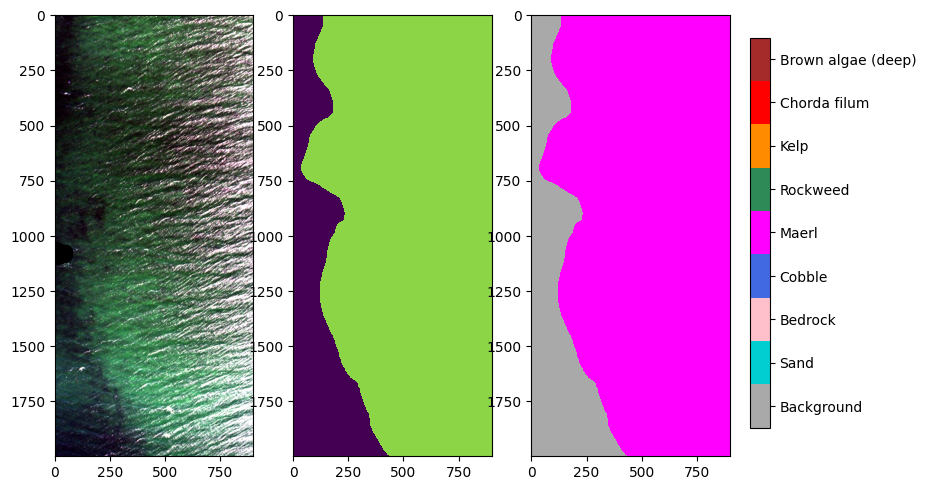

Vega_SolaNW_Sound1_Pika_L_18-Crop Wavelengths.bip.png


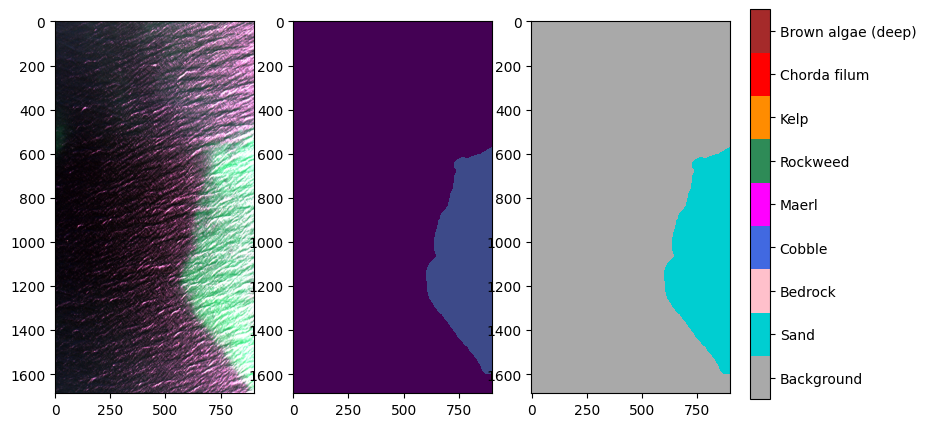

Vega_SolaNW_Sound1_Pika_L_20-Crop Wavelengths.bip.png


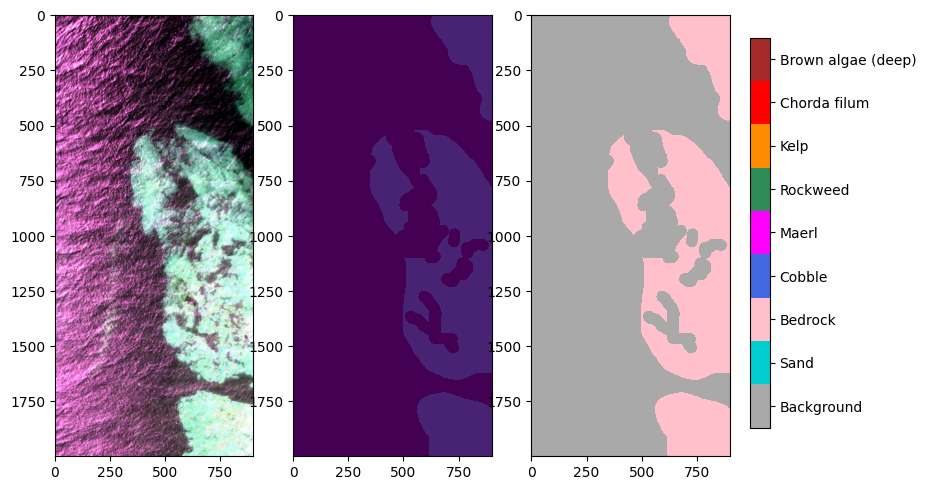

Vega_SolaNW_Sound1_Pika_L_22-Crop Wavelengths.bip.png


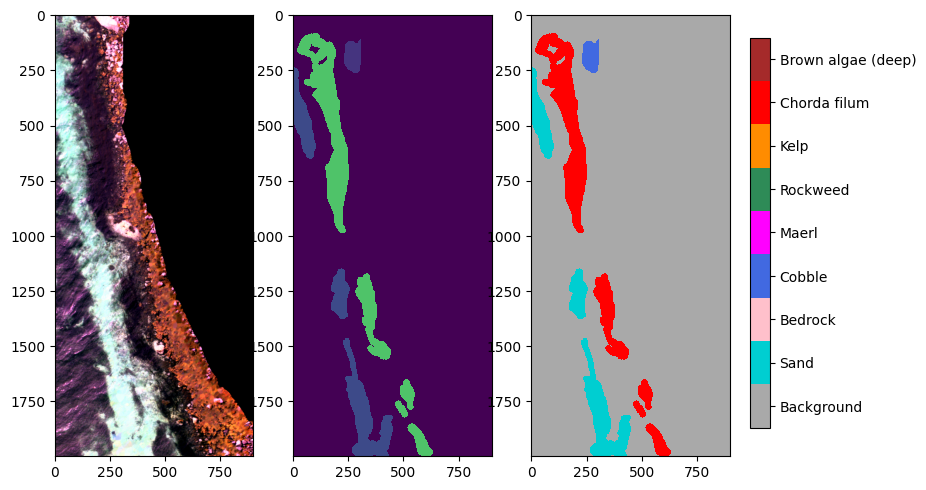

Vega_SolaNW_Sound1_Pika_L_23-Crop Wavelengths.bip.png


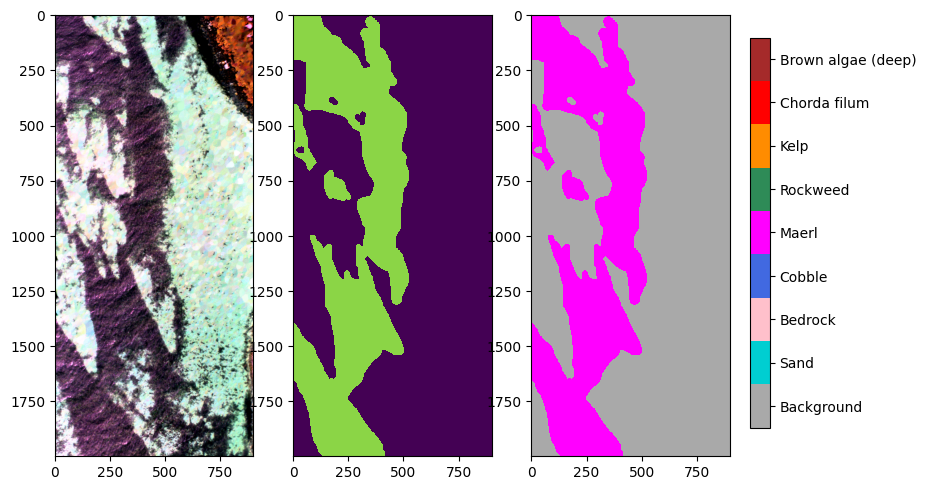

Vega_SolaNW_Sound1_Pika_L_24-Crop Wavelengths.bip.png


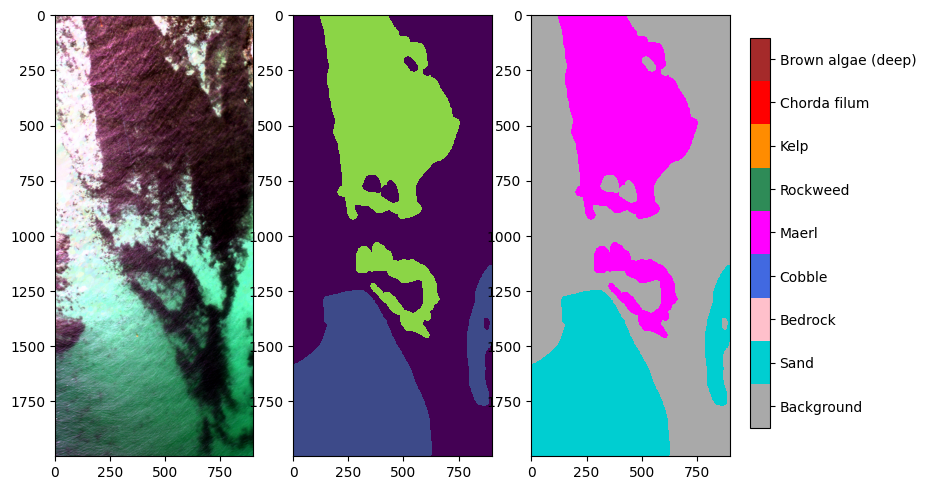

Vega_SolaNW_Sound1_Pika_L_26-Crop Wavelengths.bip.png


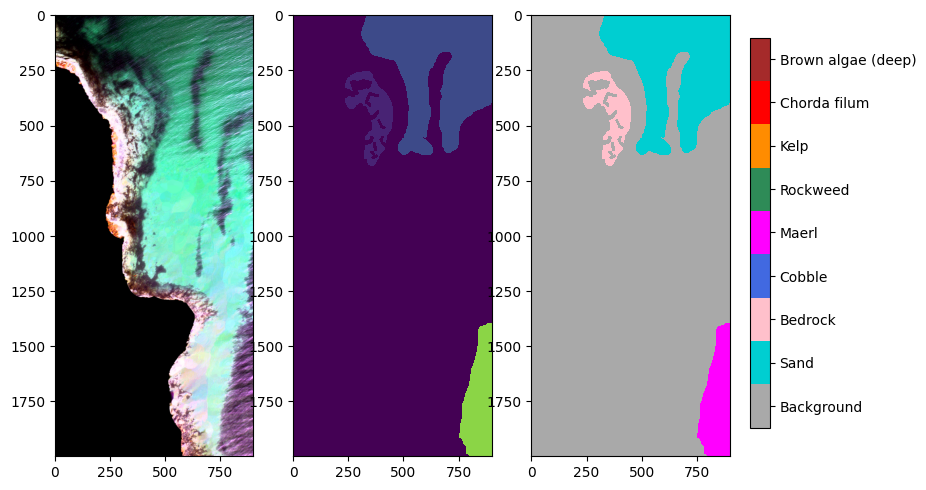

Vega_SolaNW_Sound1_Pika_L_5-Crop Wavelengths.bip.png


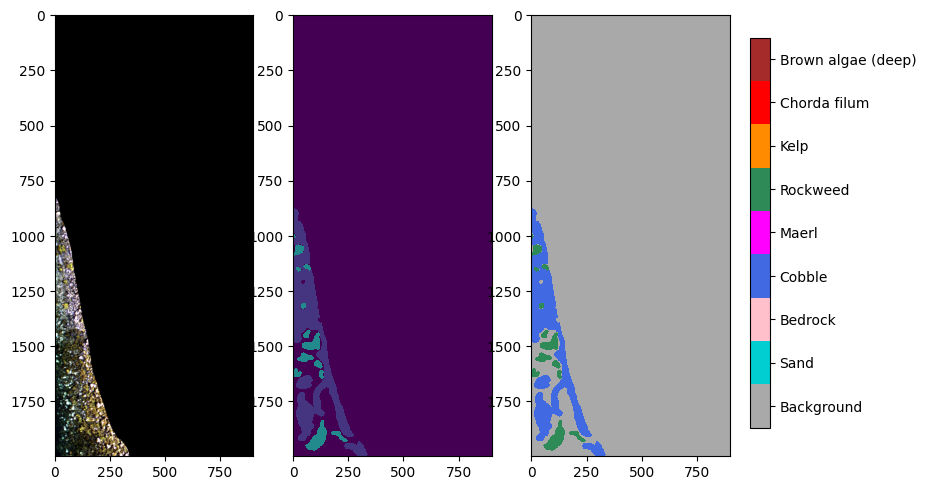

Vega_SolaNW_Sound1_Pika_L_6-Crop Wavelengths.bip.png


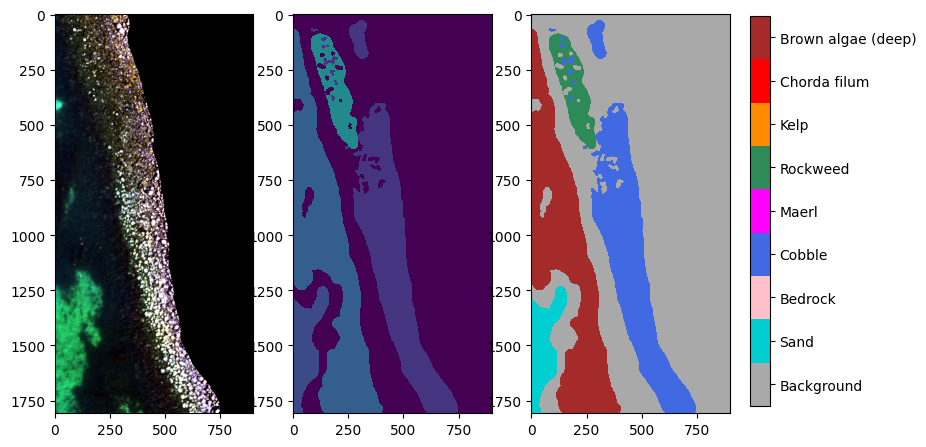

Vega_SolaNW_Sound1_Pika_L_7-Crop Wavelengths.bip.png


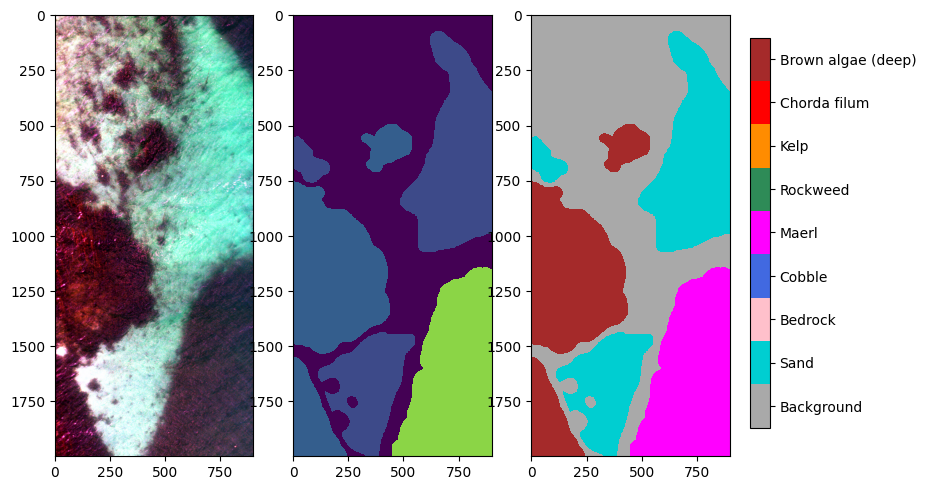

Vega_SolaNW_Sound1_Pika_L_8-Crop Wavelengths.bip.png


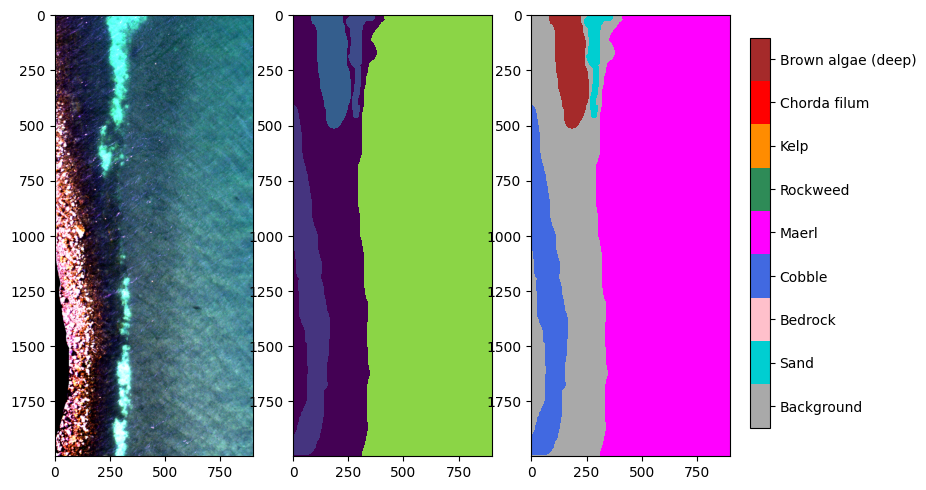

Vega_SolaNW_Sound1_Pika_L_9-Crop Wavelengths.bip.png


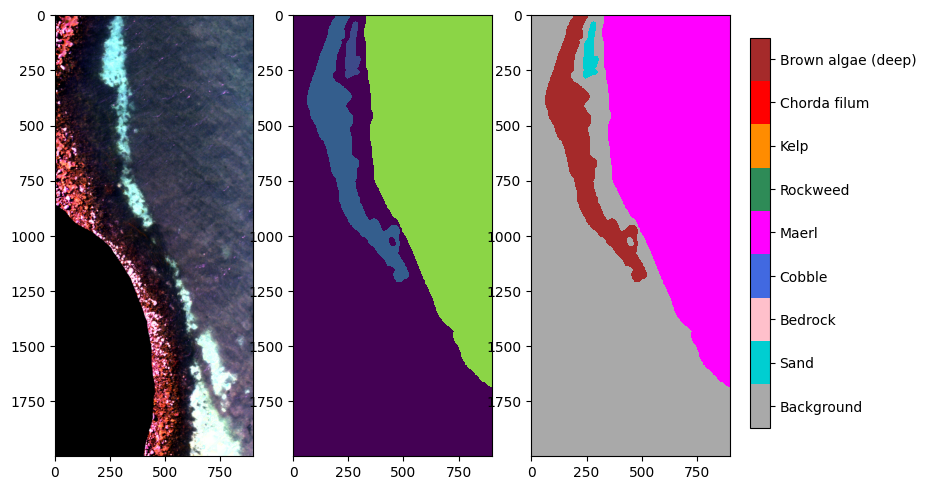

Vega_SolaNW_Sound3a_Pika_L_15-Crop Wavelengths.bip.png


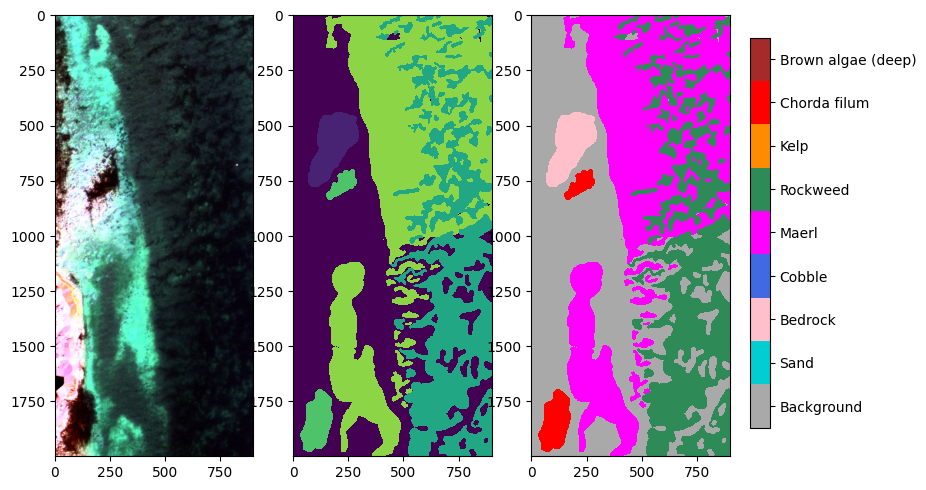

Vega_SolaNW_Sound3a_Pika_L_17-Crop Wavelengths.bip.png


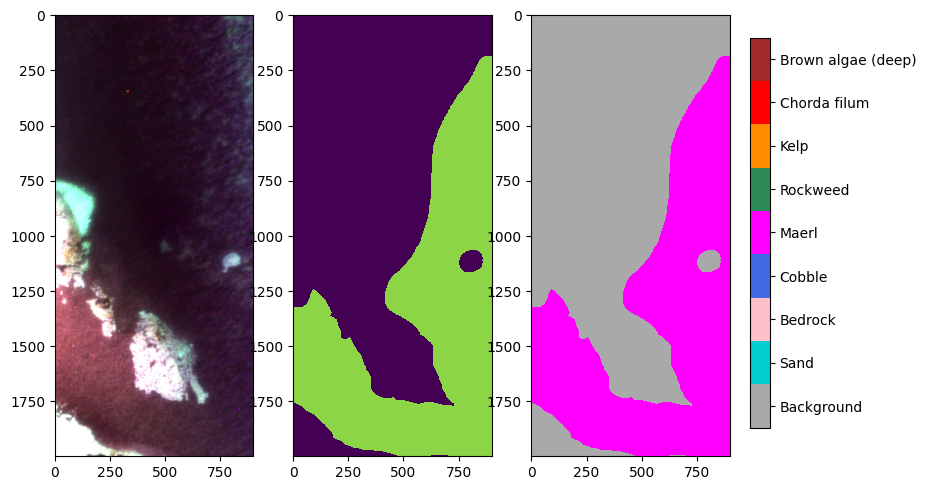

Vega_SolaNW_Sound3a_Pika_L_19-Crop Wavelengths.bip.png


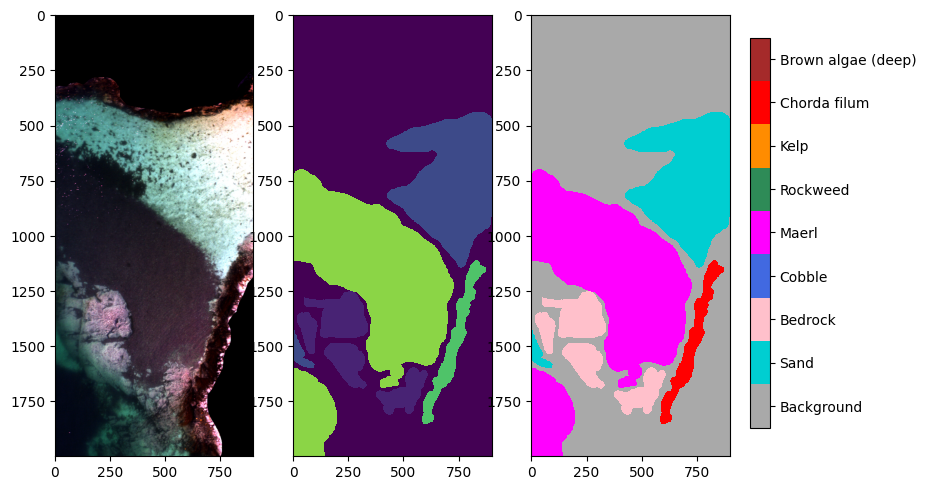

Vega_SolaNW_Sound3a_Pika_L_2-Crop Wavelengths.bip.png


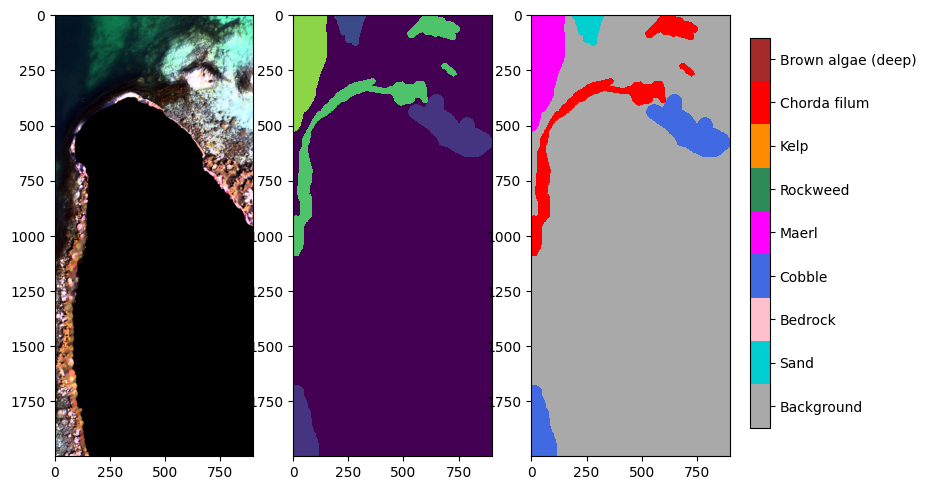

Vega_SolaNW_Sound3a_Pika_L_3-Crop Wavelengths.bip.png


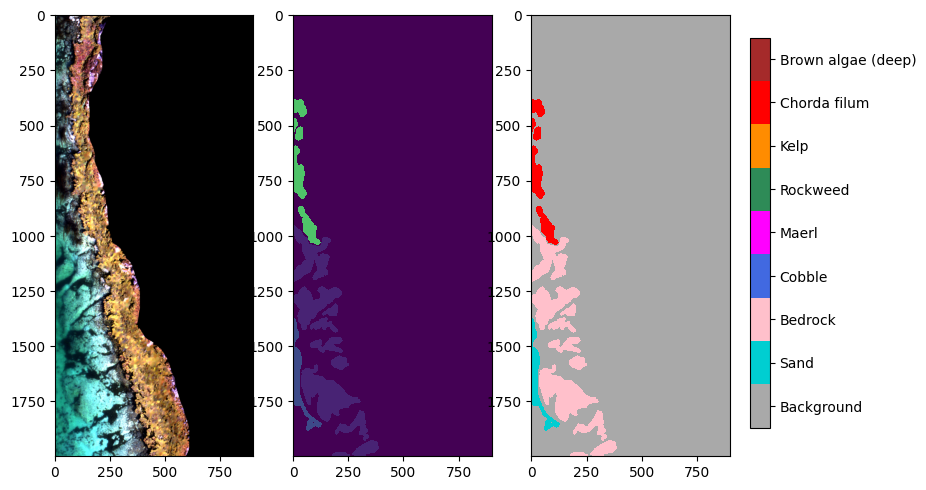

Vega_SolaNW_Sound3a_Pika_L_30-Crop Wavelengths.bip.png


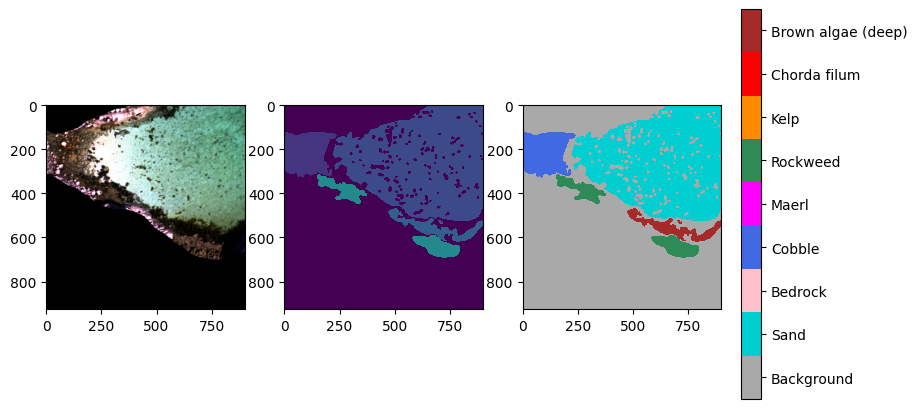

Vega_SolaNW_Sound3a_Pika_L_4-Crop Wavelengths.bip.png


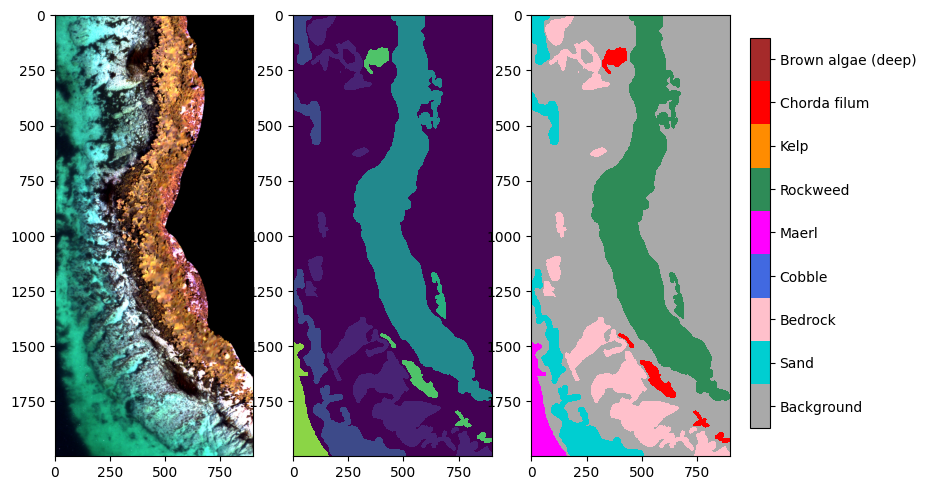

Vega_SolaNW_Sound3a_Pika_L_5-Crop Wavelengths.bip.png


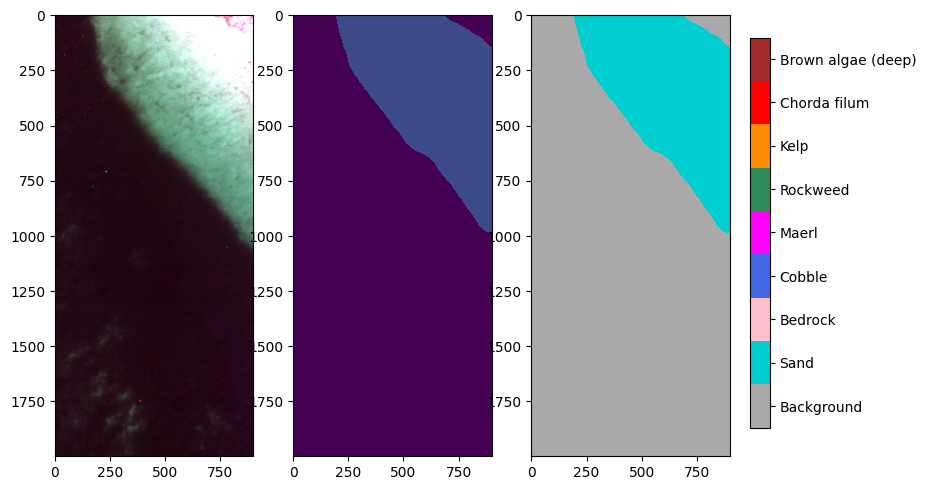

Vega_SolaNW_Sound3a_Pika_L_9-Crop Wavelengths.bip.png


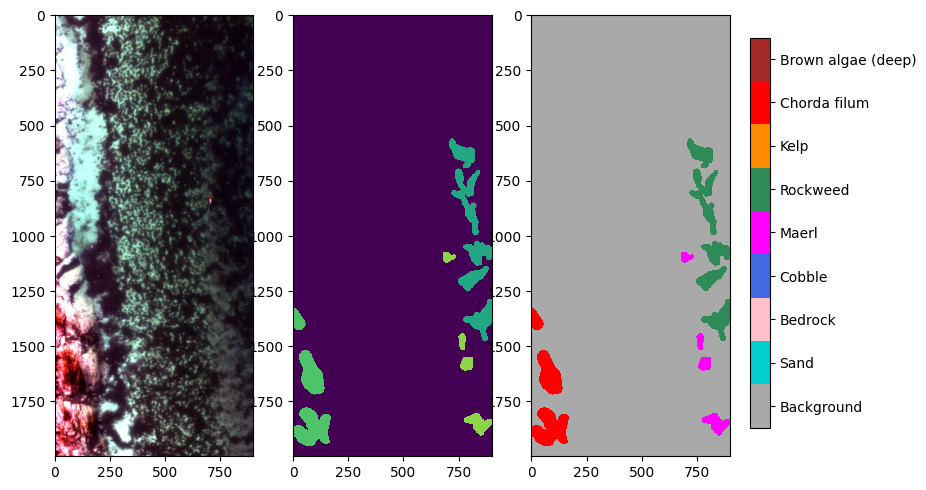

In [21]:
# Group class images and show grouped annotations
for image_file in sorted(train_val_dir.glob('*.png')):
    print(image_file.name)
    fig,ax = plt.subplots(ncols=3,figsize=(10,6))
    rgb_image_file = rgb_im_dir / image_file.name
    rgb_image = skimage.io.imread(rgb_image_file)
    ann_image = skimage.io.imread(image_file)

    group_label_im, group_indices = annotation.class_map_for_grouped_indices(
        ann_image, grouped_class_indices)
    im0 = ax[0].imshow(rgb_image)
    im1 = ax[1].imshow(ann_image,vmin=0,vmax=40,interpolation='none')
    im2 = ax[2].imshow(group_label_im,vmin=cbar_vmin,vmax=cbar_vmax,cmap=custom_cmap,interpolation='none')
    
    fig.subplots_adjust(right=0.8)                   # Make room for colorbar
    cbar_ax = fig.add_axes([0.82, 0.175, 0.02, 0.65])  # [left, bottom, width, height] 
    cbar = fig.colorbar(im2, cax=cbar_ax)
    cbar.set_ticks(cbar_ticks)
    cbar.set_ticklabels(cbar_ticklabels)
    plt.show()

{'Sand': {9}, 'Bedrock': {4}, 'Cobble': {6}, 'Maerl': {33}, 'Rockweed': {19, 20, 21, 22, 23, 24, 25, 26, 27}, 'Kelp': {13, 14, 15, 16, 17, 18}, 'Chorda filum': {29}, 'Brown algae (deep)': {12}}
group_indices={'Sand': 1, 'Bedrock': 2, 'Cobble': 3, 'Maerl': 4, 'Rockweed': 5, 'Kelp': 6, 'Chorda filum': 7, 'Brown algae (deep)': 8}
 
Classes in original image:
Bedrock
Halidrys siliquosa
Chorda filum
Maerl
 
Classes in grouped label image:
Bedrock
Maerl
Rockweed
Chorda filum


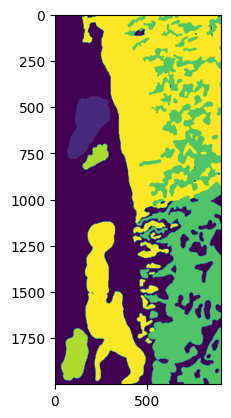

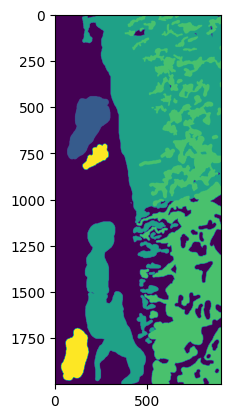

In [24]:
# More closely review example with incorrect grouping
image_file = train_val_dir / 'Vega_SolaNW_Sound3a_Pika_L_15-Crop Wavelengths.bip.png'

#fig,ax = plt.subplots(ncols=3,figsize=(10,6))
rgb_image_file = rgb_im_dir / image_file
rgb_image = skimage.io.imread(rgb_image_file)
ann_image = skimage.io.imread(image_file)

group_label_im, group_indices = annotation.class_map_for_grouped_indices(
    ann_image, grouped_class_indices)

print(grouped_class_indices)
print(f'{group_indices=}')
print(' ')

inv_class_indices = {value:key for key, value in class_indices.items()}
 
print('Classes in original image:')
for i in np.unique(ann_image):
    if i in inv_class_indices:
        print(inv_class_indices[i])
        
inv_group_indices = {value:key for key, value in group_indices.items()}

print(' ')
print('Classes in grouped label image:')
for i in np.unique(group_label_im):
    if i in inv_group_indices:
        print(inv_group_indices[i])

plt.imshow(ann_image)
plt.show()
plt.imshow(group_label_im)
plt.show()




In [ ]:
group_indices